# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: data: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

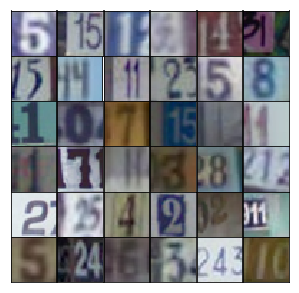

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):

        x1 = tf.contrib.layers.fully_connected(inputs=z, 
                               num_outputs=4*4*512,
                               activation_fn=None,
                               weights_initializer=tf.truncated_normal_initializer(mean=0, stddev=0.02))
        x1 = tf.reshape(x1,[-1,4,4,512])
        x1 = tf.layers.batch_normalization(inputs=x1, training=training)
        x1 = tf.maximum(x1 * alpha, x1)
        # now it's 4 * 4 * 512
        
        
        x2 = tf.layers.conv2d_transpose(inputs=x1,
                                        filters=256,
                                        kernel_size=[5,5],
                                        strides=[2,2],
                                        padding='same')
        x2 = tf.layers.batch_normalization(inputs=x2, training=training)
        x2 = tf.maximum(x2 * alpha, x2)
        # now it's 8 * 8 * 256
        
        
        x3 = tf.layers.conv2d_transpose(inputs=x2,
                                        filters=128,
                                        kernel_size=[5,5],
                                        strides=[2,2],
                                        padding='same')
        x3 = tf.layers.batch_normalization(inputs=x3, training=training)
        x3 = tf.maximum(x3 * alpha, x3)
        # now it's 16 * 16 * 128
        

        x4 = tf.layers.conv2d_transpose(inputs=x3,
                                        filters=output_dim,
                                        kernel_size=[5,5],
                                        strides=[2,2],
                                        padding='same')
        # now it's 32 * 32 * output_dim
                
        logits = x4
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(inputs=x,
                              filters=32,
                              kernel_size=[5,5],
                              strides=[2,2],
                              padding='same')
        x1 = tf.maximum(x1 * alpha, x1)
        # now it's 16 * 16 * 32
        
        x2 = tf.layers.conv2d(inputs=x1,
                              filters=64,
                              kernel_size=[5,5],
                              strides=[2,2],
                              padding='same')
        x2 = tf.layers.batch_normalization(inputs=x2, training=True)
        x2 = tf.maximum(x2 * alpha, x2)
        # now it's 8 * 8 * 64
        
        x3 = tf.layers.conv2d(inputs=x2,
                              filters=128,
                              kernel_size=[5,5],
                              strides=[2,2],
                              padding='same')
        x3 = tf.layers.batch_normalization(inputs=x3, training=True)
        x3 = tf.maximum(x3 * alpha, x3)
        # now it's 4 * 4 * 128
        
        
        flatten = tf.reshape(x3, [-1,4*4*128])
        
        logits = tf.contrib.layers.fully_connected(inputs=flatten,
                                           num_outputs=1,
                                           activation_fn=None,
                                           weights_initializer=tf.truncated_normal_initializer(mean=0.0, stddev=0.02))
        
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()
        
        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 20
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/20... Discriminator Loss: 3.4813... Generator Loss: 0.0612
Epoch 1/20... Discriminator Loss: 2.7022... Generator Loss: 0.1562
Epoch 1/20... Discriminator Loss: 2.0547... Generator Loss: 0.3011
Epoch 1/20... Discriminator Loss: 1.2815... Generator Loss: 0.7241
Epoch 1/20... Discriminator Loss: 1.1480... Generator Loss: 1.0182
Epoch 1/20... Discriminator Loss: 0.8805... Generator Loss: 1.0542
Epoch 1/20... Discriminator Loss: 0.7380... Generator Loss: 1.1867
Epoch 1/20... Discriminator Loss: 0.8037... Generator Loss: 1.2404
Epoch 1/20... Discriminator Loss: 0.7312... Generator Loss: 1.3101
Epoch 1/20... Discriminator Loss: 0.8367... Generator Loss: 1.1830


/anaconda3/envs/gan/lib/python3.6/site-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


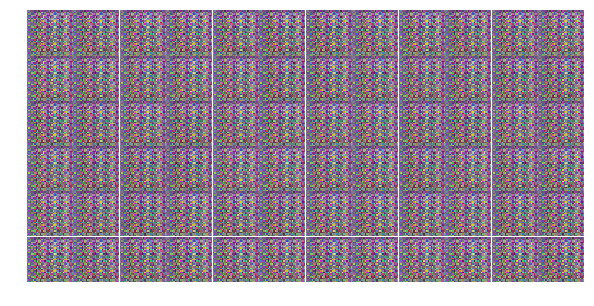

Epoch 1/20... Discriminator Loss: 0.5644... Generator Loss: 1.5180
Epoch 1/20... Discriminator Loss: 0.7152... Generator Loss: 1.2871
Epoch 1/20... Discriminator Loss: 0.5033... Generator Loss: 1.6675
Epoch 1/20... Discriminator Loss: 0.6712... Generator Loss: 1.2780
Epoch 1/20... Discriminator Loss: 0.8407... Generator Loss: 1.4370
Epoch 1/20... Discriminator Loss: 0.3908... Generator Loss: 1.9521
Epoch 1/20... Discriminator Loss: 0.7007... Generator Loss: 1.0737
Epoch 1/20... Discriminator Loss: 1.3718... Generator Loss: 0.7525
Epoch 1/20... Discriminator Loss: 1.6639... Generator Loss: 0.5837
Epoch 1/20... Discriminator Loss: 1.1685... Generator Loss: 0.9521


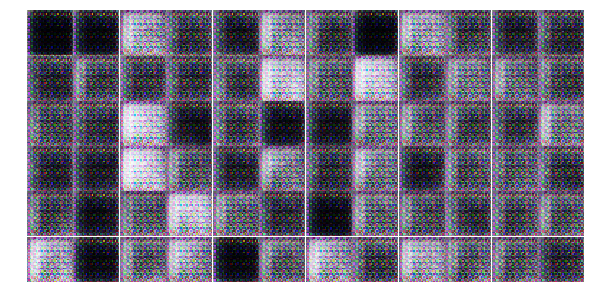

Epoch 1/20... Discriminator Loss: 1.1339... Generator Loss: 1.0016
Epoch 1/20... Discriminator Loss: 1.0497... Generator Loss: 0.9914
Epoch 1/20... Discriminator Loss: 1.2959... Generator Loss: 0.7676
Epoch 1/20... Discriminator Loss: 1.1070... Generator Loss: 0.7056
Epoch 1/20... Discriminator Loss: 0.6362... Generator Loss: 1.4558
Epoch 1/20... Discriminator Loss: 0.7967... Generator Loss: 1.5768
Epoch 1/20... Discriminator Loss: 1.0263... Generator Loss: 0.8528
Epoch 1/20... Discriminator Loss: 0.9204... Generator Loss: 1.0982
Epoch 1/20... Discriminator Loss: 0.8797... Generator Loss: 1.6121
Epoch 1/20... Discriminator Loss: 0.8134... Generator Loss: 0.8966


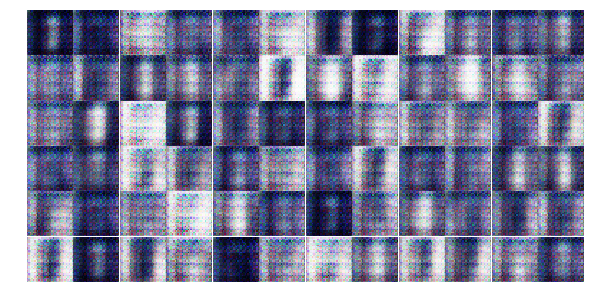

Epoch 1/20... Discriminator Loss: 0.7575... Generator Loss: 0.9825
Epoch 1/20... Discriminator Loss: 1.3106... Generator Loss: 3.7176
Epoch 1/20... Discriminator Loss: 0.4057... Generator Loss: 1.9358
Epoch 1/20... Discriminator Loss: 0.5802... Generator Loss: 1.2638
Epoch 1/20... Discriminator Loss: 0.8997... Generator Loss: 0.7863
Epoch 1/20... Discriminator Loss: 0.5349... Generator Loss: 1.4253
Epoch 1/20... Discriminator Loss: 0.4424... Generator Loss: 1.8918
Epoch 1/20... Discriminator Loss: 0.9312... Generator Loss: 2.4086
Epoch 1/20... Discriminator Loss: 0.5824... Generator Loss: 1.9604
Epoch 1/20... Discriminator Loss: 0.7378... Generator Loss: 1.2628


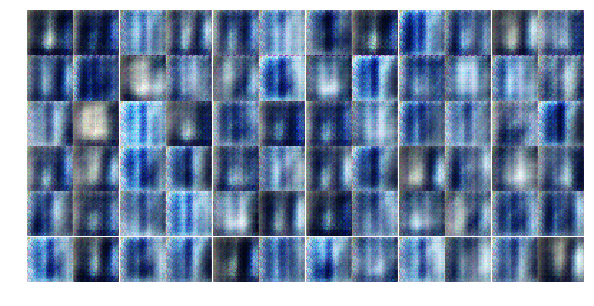

Epoch 1/20... Discriminator Loss: 1.0173... Generator Loss: 1.2975
Epoch 1/20... Discriminator Loss: 1.0995... Generator Loss: 0.8260
Epoch 1/20... Discriminator Loss: 1.1979... Generator Loss: 0.7764
Epoch 1/20... Discriminator Loss: 1.0370... Generator Loss: 1.2360
Epoch 1/20... Discriminator Loss: 1.3954... Generator Loss: 0.7522
Epoch 1/20... Discriminator Loss: 1.4319... Generator Loss: 0.6656
Epoch 1/20... Discriminator Loss: 1.2923... Generator Loss: 0.7742
Epoch 1/20... Discriminator Loss: 1.1586... Generator Loss: 0.8912
Epoch 1/20... Discriminator Loss: 1.1669... Generator Loss: 0.8189
Epoch 1/20... Discriminator Loss: 1.0629... Generator Loss: 0.9760


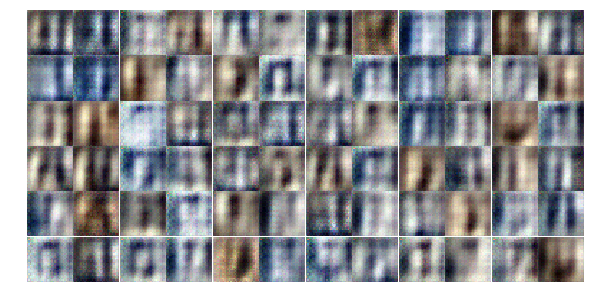

Epoch 1/20... Discriminator Loss: 1.0315... Generator Loss: 0.9727
Epoch 1/20... Discriminator Loss: 1.1968... Generator Loss: 0.7777
Epoch 1/20... Discriminator Loss: 1.1473... Generator Loss: 0.8645
Epoch 1/20... Discriminator Loss: 1.3475... Generator Loss: 0.7927
Epoch 1/20... Discriminator Loss: 1.0765... Generator Loss: 0.9464
Epoch 1/20... Discriminator Loss: 1.3377... Generator Loss: 0.6736
Epoch 1/20... Discriminator Loss: 1.1489... Generator Loss: 0.8756
Epoch 2/20... Discriminator Loss: 1.2003... Generator Loss: 0.8634
Epoch 2/20... Discriminator Loss: 1.1828... Generator Loss: 0.9357
Epoch 2/20... Discriminator Loss: 1.3319... Generator Loss: 0.8659


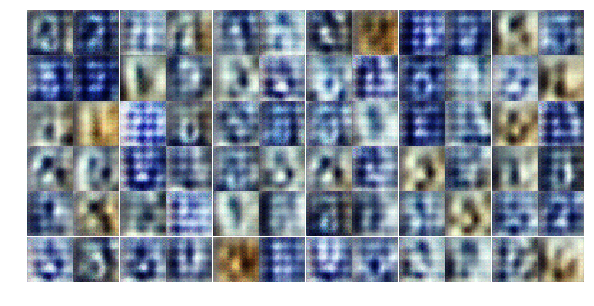

Epoch 2/20... Discriminator Loss: 1.3183... Generator Loss: 0.7549
Epoch 2/20... Discriminator Loss: 1.2555... Generator Loss: 0.8153
Epoch 2/20... Discriminator Loss: 1.1737... Generator Loss: 0.8898
Epoch 2/20... Discriminator Loss: 1.1875... Generator Loss: 0.8809
Epoch 2/20... Discriminator Loss: 1.2084... Generator Loss: 0.9022
Epoch 2/20... Discriminator Loss: 1.1328... Generator Loss: 1.0004
Epoch 2/20... Discriminator Loss: 1.1054... Generator Loss: 0.8598
Epoch 2/20... Discriminator Loss: 1.1697... Generator Loss: 0.8584
Epoch 2/20... Discriminator Loss: 1.1716... Generator Loss: 0.8746
Epoch 2/20... Discriminator Loss: 1.4340... Generator Loss: 0.6020


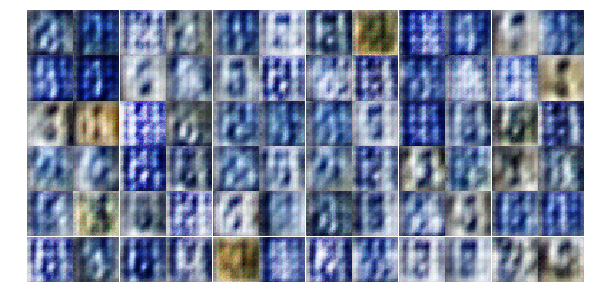

Epoch 2/20... Discriminator Loss: 1.3115... Generator Loss: 0.7566
Epoch 2/20... Discriminator Loss: 1.0683... Generator Loss: 0.8519
Epoch 2/20... Discriminator Loss: 0.9970... Generator Loss: 1.0887
Epoch 2/20... Discriminator Loss: 1.1442... Generator Loss: 0.9536
Epoch 2/20... Discriminator Loss: 1.3707... Generator Loss: 0.7207
Epoch 2/20... Discriminator Loss: 1.4374... Generator Loss: 0.8055
Epoch 2/20... Discriminator Loss: 1.4984... Generator Loss: 0.6661
Epoch 2/20... Discriminator Loss: 1.2411... Generator Loss: 0.7702
Epoch 2/20... Discriminator Loss: 1.3661... Generator Loss: 0.7748
Epoch 2/20... Discriminator Loss: 1.1793... Generator Loss: 0.8976


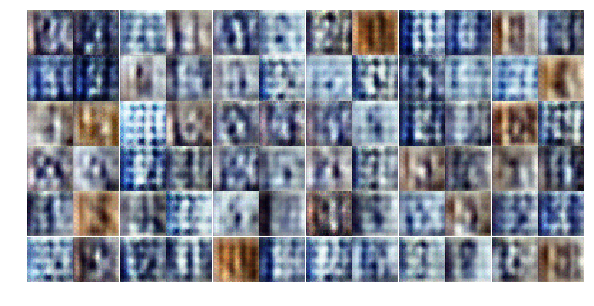

Epoch 2/20... Discriminator Loss: 1.3949... Generator Loss: 0.7391
Epoch 2/20... Discriminator Loss: 1.3266... Generator Loss: 0.7815
Epoch 2/20... Discriminator Loss: 1.3234... Generator Loss: 0.7670
Epoch 2/20... Discriminator Loss: 1.3405... Generator Loss: 0.7000
Epoch 2/20... Discriminator Loss: 1.2060... Generator Loss: 0.8408
Epoch 2/20... Discriminator Loss: 1.2481... Generator Loss: 0.8643
Epoch 2/20... Discriminator Loss: 1.1726... Generator Loss: 0.8846
Epoch 2/20... Discriminator Loss: 1.3611... Generator Loss: 0.7443
Epoch 2/20... Discriminator Loss: 1.3310... Generator Loss: 0.8323
Epoch 2/20... Discriminator Loss: 1.2511... Generator Loss: 0.7607


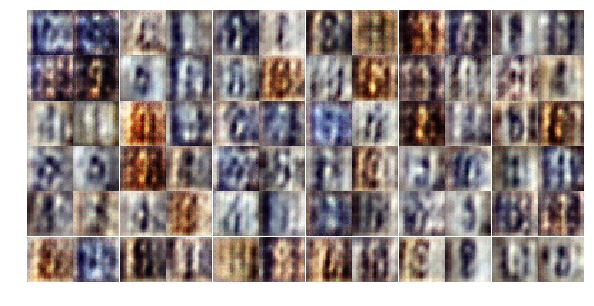

Epoch 2/20... Discriminator Loss: 1.2838... Generator Loss: 0.7281
Epoch 2/20... Discriminator Loss: 1.3280... Generator Loss: 0.7701
Epoch 2/20... Discriminator Loss: 1.3562... Generator Loss: 0.7741
Epoch 2/20... Discriminator Loss: 1.4312... Generator Loss: 0.7323
Epoch 2/20... Discriminator Loss: 1.2970... Generator Loss: 0.7672
Epoch 2/20... Discriminator Loss: 1.1909... Generator Loss: 0.8177
Epoch 2/20... Discriminator Loss: 1.2543... Generator Loss: 0.8451
Epoch 2/20... Discriminator Loss: 1.2646... Generator Loss: 0.7883
Epoch 2/20... Discriminator Loss: 1.2577... Generator Loss: 0.8248
Epoch 2/20... Discriminator Loss: 1.5837... Generator Loss: 0.6568


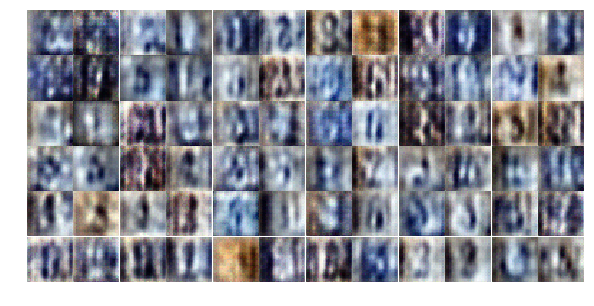

Epoch 2/20... Discriminator Loss: 1.2546... Generator Loss: 0.8611
Epoch 2/20... Discriminator Loss: 1.3254... Generator Loss: 0.8136
Epoch 2/20... Discriminator Loss: 1.4384... Generator Loss: 0.6954
Epoch 2/20... Discriminator Loss: 1.2890... Generator Loss: 0.7849
Epoch 2/20... Discriminator Loss: 1.4156... Generator Loss: 0.7750
Epoch 2/20... Discriminator Loss: 1.3513... Generator Loss: 0.7809
Epoch 2/20... Discriminator Loss: 1.4452... Generator Loss: 0.6316
Epoch 2/20... Discriminator Loss: 1.3074... Generator Loss: 0.7487
Epoch 2/20... Discriminator Loss: 1.2793... Generator Loss: 0.6701
Epoch 2/20... Discriminator Loss: 1.3911... Generator Loss: 0.6830


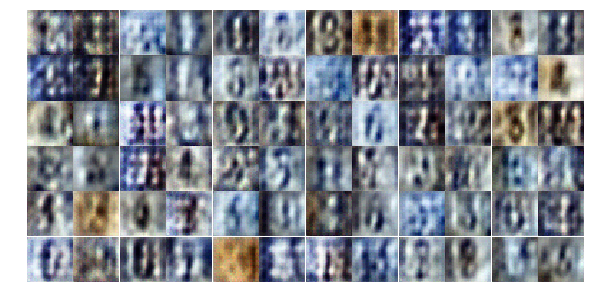

Epoch 2/20... Discriminator Loss: 1.3049... Generator Loss: 0.7362
Epoch 2/20... Discriminator Loss: 1.3894... Generator Loss: 0.7705
Epoch 2/20... Discriminator Loss: 1.3469... Generator Loss: 0.7721
Epoch 2/20... Discriminator Loss: 1.4033... Generator Loss: 0.7533
Epoch 3/20... Discriminator Loss: 1.1858... Generator Loss: 0.7612
Epoch 3/20... Discriminator Loss: 1.3155... Generator Loss: 0.7620
Epoch 3/20... Discriminator Loss: 1.3980... Generator Loss: 0.6865
Epoch 3/20... Discriminator Loss: 1.4799... Generator Loss: 0.6905
Epoch 3/20... Discriminator Loss: 1.3545... Generator Loss: 0.7484
Epoch 3/20... Discriminator Loss: 1.3953... Generator Loss: 0.6898


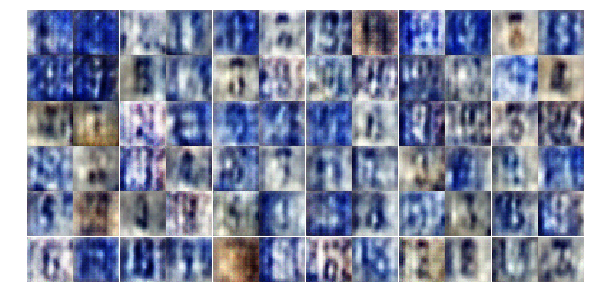

Epoch 3/20... Discriminator Loss: 1.3040... Generator Loss: 0.7556
Epoch 3/20... Discriminator Loss: 1.4361... Generator Loss: 0.7075
Epoch 3/20... Discriminator Loss: 1.3774... Generator Loss: 0.7292
Epoch 3/20... Discriminator Loss: 1.3296... Generator Loss: 0.7517
Epoch 3/20... Discriminator Loss: 1.5089... Generator Loss: 0.6208
Epoch 3/20... Discriminator Loss: 1.4328... Generator Loss: 0.7188
Epoch 3/20... Discriminator Loss: 1.4322... Generator Loss: 0.7333
Epoch 3/20... Discriminator Loss: 1.3133... Generator Loss: 0.7216
Epoch 3/20... Discriminator Loss: 1.3509... Generator Loss: 0.6952
Epoch 3/20... Discriminator Loss: 1.3913... Generator Loss: 0.7224


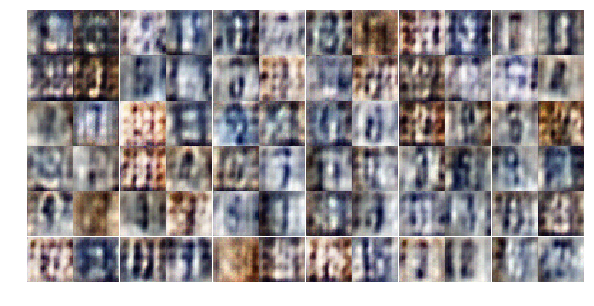

Epoch 3/20... Discriminator Loss: 1.3465... Generator Loss: 0.7421
Epoch 3/20... Discriminator Loss: 1.4128... Generator Loss: 0.7120
Epoch 3/20... Discriminator Loss: 1.2882... Generator Loss: 0.7358
Epoch 3/20... Discriminator Loss: 1.2124... Generator Loss: 0.8617
Epoch 3/20... Discriminator Loss: 1.4233... Generator Loss: 0.7425
Epoch 3/20... Discriminator Loss: 1.3453... Generator Loss: 0.7475
Epoch 3/20... Discriminator Loss: 1.3058... Generator Loss: 0.6798
Epoch 3/20... Discriminator Loss: 1.4529... Generator Loss: 0.6632
Epoch 3/20... Discriminator Loss: 1.4269... Generator Loss: 0.6593
Epoch 3/20... Discriminator Loss: 1.3441... Generator Loss: 0.7542


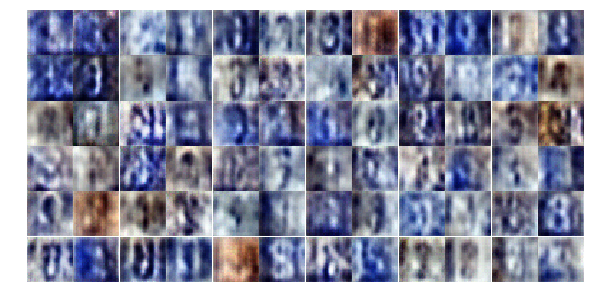

Epoch 3/20... Discriminator Loss: 1.4307... Generator Loss: 0.6798
Epoch 3/20... Discriminator Loss: 1.4660... Generator Loss: 0.6742
Epoch 3/20... Discriminator Loss: 1.3477... Generator Loss: 0.7011
Epoch 3/20... Discriminator Loss: 1.3920... Generator Loss: 0.6795
Epoch 3/20... Discriminator Loss: 1.4663... Generator Loss: 0.6909
Epoch 3/20... Discriminator Loss: 1.3141... Generator Loss: 0.7785
Epoch 3/20... Discriminator Loss: 1.2507... Generator Loss: 0.7866
Epoch 3/20... Discriminator Loss: 1.4788... Generator Loss: 0.6738
Epoch 3/20... Discriminator Loss: 1.5380... Generator Loss: 0.6589
Epoch 3/20... Discriminator Loss: 1.5122... Generator Loss: 0.7011


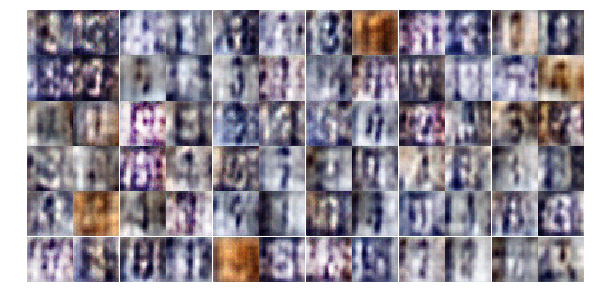

Epoch 3/20... Discriminator Loss: 1.3827... Generator Loss: 0.7086
Epoch 3/20... Discriminator Loss: 1.3017... Generator Loss: 0.6781
Epoch 3/20... Discriminator Loss: 1.6241... Generator Loss: 0.6622
Epoch 3/20... Discriminator Loss: 1.4010... Generator Loss: 0.7470
Epoch 3/20... Discriminator Loss: 1.5065... Generator Loss: 0.5664
Epoch 3/20... Discriminator Loss: 1.3360... Generator Loss: 0.6837
Epoch 3/20... Discriminator Loss: 1.5005... Generator Loss: 0.6397
Epoch 3/20... Discriminator Loss: 1.3051... Generator Loss: 0.8329
Epoch 3/20... Discriminator Loss: 1.1559... Generator Loss: 0.7480
Epoch 3/20... Discriminator Loss: 1.4548... Generator Loss: 0.7268


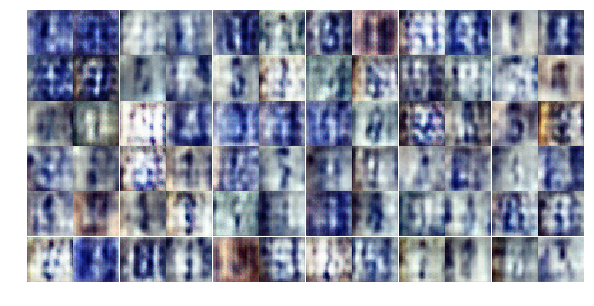

Epoch 3/20... Discriminator Loss: 1.3797... Generator Loss: 0.6955
Epoch 3/20... Discriminator Loss: 1.3097... Generator Loss: 0.6929
Epoch 3/20... Discriminator Loss: 1.3033... Generator Loss: 0.7938
Epoch 3/20... Discriminator Loss: 1.5615... Generator Loss: 0.6473
Epoch 3/20... Discriminator Loss: 1.2180... Generator Loss: 0.7802
Epoch 3/20... Discriminator Loss: 1.3907... Generator Loss: 0.7206
Epoch 3/20... Discriminator Loss: 1.4354... Generator Loss: 0.6627
Epoch 3/20... Discriminator Loss: 1.2492... Generator Loss: 0.7663
Epoch 3/20... Discriminator Loss: 1.4291... Generator Loss: 0.6517
Epoch 3/20... Discriminator Loss: 1.3826... Generator Loss: 0.7257


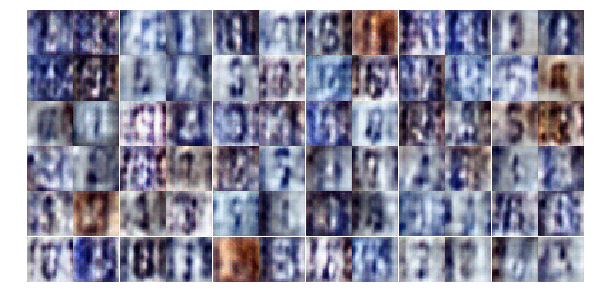

Epoch 3/20... Discriminator Loss: 1.4640... Generator Loss: 0.6780
Epoch 4/20... Discriminator Loss: 1.2892... Generator Loss: 0.8127
Epoch 4/20... Discriminator Loss: 1.3651... Generator Loss: 0.6806
Epoch 4/20... Discriminator Loss: 1.4325... Generator Loss: 0.6394
Epoch 4/20... Discriminator Loss: 1.3556... Generator Loss: 0.6879
Epoch 4/20... Discriminator Loss: 1.3542... Generator Loss: 0.7478
Epoch 4/20... Discriminator Loss: 1.2612... Generator Loss: 0.7537
Epoch 4/20... Discriminator Loss: 1.4955... Generator Loss: 0.6862
Epoch 4/20... Discriminator Loss: 1.4714... Generator Loss: 0.6620
Epoch 4/20... Discriminator Loss: 1.3652... Generator Loss: 0.7222


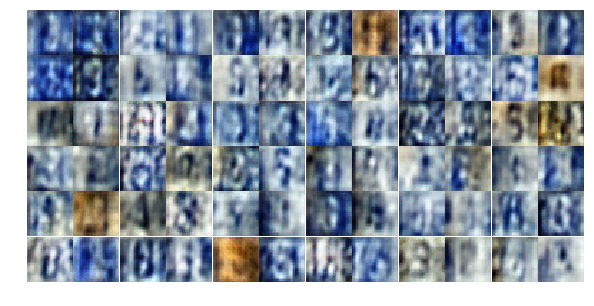

Epoch 4/20... Discriminator Loss: 1.3937... Generator Loss: 0.7035
Epoch 4/20... Discriminator Loss: 1.4482... Generator Loss: 0.7273
Epoch 4/20... Discriminator Loss: 1.3140... Generator Loss: 0.7322
Epoch 4/20... Discriminator Loss: 1.4497... Generator Loss: 0.6934
Epoch 4/20... Discriminator Loss: 1.3791... Generator Loss: 0.7028
Epoch 4/20... Discriminator Loss: 1.3445... Generator Loss: 0.7444
Epoch 4/20... Discriminator Loss: 1.3717... Generator Loss: 0.7000
Epoch 4/20... Discriminator Loss: 1.4398... Generator Loss: 0.6919
Epoch 4/20... Discriminator Loss: 1.3977... Generator Loss: 0.7099
Epoch 4/20... Discriminator Loss: 1.3723... Generator Loss: 0.7112


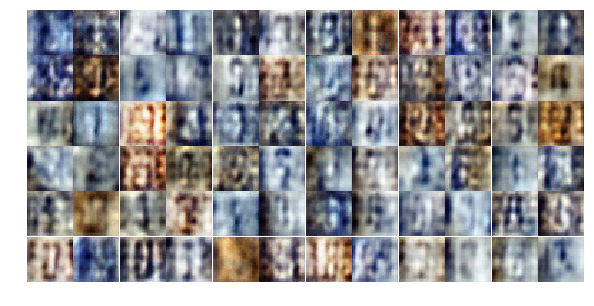

Epoch 4/20... Discriminator Loss: 1.4038... Generator Loss: 0.6883
Epoch 4/20... Discriminator Loss: 1.4071... Generator Loss: 0.7025
Epoch 4/20... Discriminator Loss: 1.4090... Generator Loss: 0.7042
Epoch 4/20... Discriminator Loss: 1.4113... Generator Loss: 0.7117
Epoch 4/20... Discriminator Loss: 1.3795... Generator Loss: 0.7084
Epoch 4/20... Discriminator Loss: 1.3860... Generator Loss: 0.7221
Epoch 4/20... Discriminator Loss: 1.3144... Generator Loss: 0.7373
Epoch 4/20... Discriminator Loss: 1.3503... Generator Loss: 0.7214
Epoch 4/20... Discriminator Loss: 1.3819... Generator Loss: 0.7293
Epoch 4/20... Discriminator Loss: 1.2229... Generator Loss: 0.7806


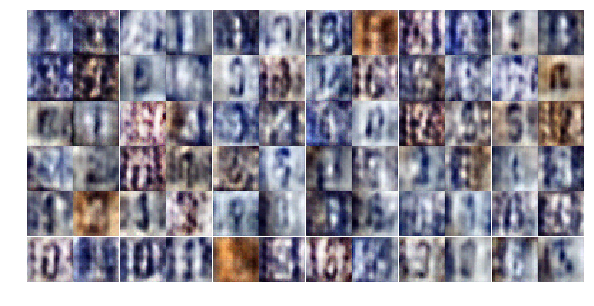

Epoch 4/20... Discriminator Loss: 1.3621... Generator Loss: 0.6994
Epoch 4/20... Discriminator Loss: 1.4381... Generator Loss: 0.6618
Epoch 4/20... Discriminator Loss: 1.3107... Generator Loss: 0.7877
Epoch 4/20... Discriminator Loss: 1.3638... Generator Loss: 0.7026
Epoch 4/20... Discriminator Loss: 1.3349... Generator Loss: 0.7135
Epoch 4/20... Discriminator Loss: 1.3833... Generator Loss: 0.7227
Epoch 4/20... Discriminator Loss: 1.3932... Generator Loss: 0.7003
Epoch 4/20... Discriminator Loss: 1.3445... Generator Loss: 0.7158
Epoch 4/20... Discriminator Loss: 1.4212... Generator Loss: 0.7091
Epoch 4/20... Discriminator Loss: 1.2393... Generator Loss: 0.7086


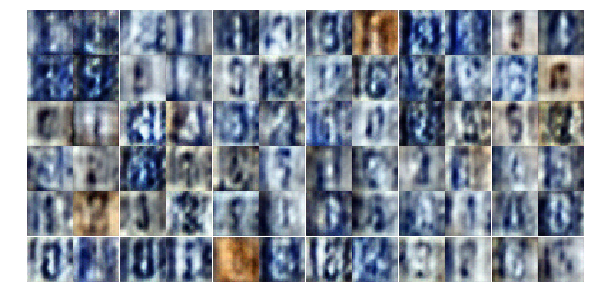

Epoch 4/20... Discriminator Loss: 1.4015... Generator Loss: 0.7319
Epoch 4/20... Discriminator Loss: 1.3467... Generator Loss: 0.7742
Epoch 4/20... Discriminator Loss: 1.3801... Generator Loss: 0.6528
Epoch 4/20... Discriminator Loss: 1.3487... Generator Loss: 0.7162
Epoch 4/20... Discriminator Loss: 1.3933... Generator Loss: 0.7088
Epoch 4/20... Discriminator Loss: 1.3445... Generator Loss: 0.7832
Epoch 4/20... Discriminator Loss: 1.2943... Generator Loss: 0.6939
Epoch 4/20... Discriminator Loss: 1.4329... Generator Loss: 0.6698
Epoch 4/20... Discriminator Loss: 1.2554... Generator Loss: 0.7464
Epoch 4/20... Discriminator Loss: 1.4188... Generator Loss: 0.6759


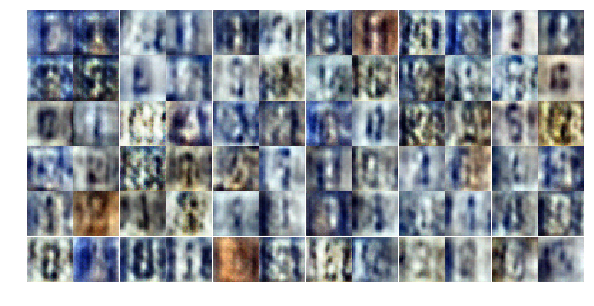

Epoch 4/20... Discriminator Loss: 1.3798... Generator Loss: 0.7395
Epoch 4/20... Discriminator Loss: 1.3584... Generator Loss: 0.7324
Epoch 4/20... Discriminator Loss: 1.3925... Generator Loss: 0.7148
Epoch 4/20... Discriminator Loss: 1.2681... Generator Loss: 0.7782
Epoch 4/20... Discriminator Loss: 1.2857... Generator Loss: 0.7358
Epoch 4/20... Discriminator Loss: 1.3306... Generator Loss: 0.7705
Epoch 4/20... Discriminator Loss: 1.3662... Generator Loss: 0.6816
Epoch 4/20... Discriminator Loss: 1.3613... Generator Loss: 0.7197
Epoch 4/20... Discriminator Loss: 1.3355... Generator Loss: 0.7448
Epoch 5/20... Discriminator Loss: 1.4040... Generator Loss: 0.6931


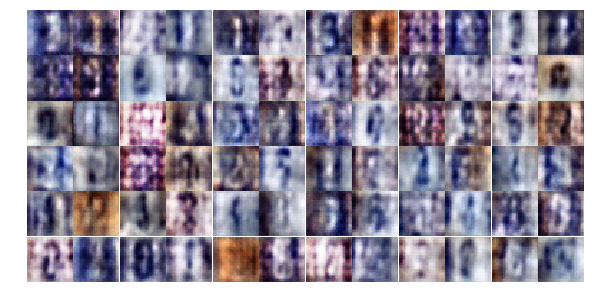

Epoch 5/20... Discriminator Loss: 1.4004... Generator Loss: 0.6995
Epoch 5/20... Discriminator Loss: 1.1951... Generator Loss: 0.7597
Epoch 5/20... Discriminator Loss: 1.3755... Generator Loss: 0.7016
Epoch 5/20... Discriminator Loss: 1.3584... Generator Loss: 0.7149
Epoch 5/20... Discriminator Loss: 1.3043... Generator Loss: 0.7566
Epoch 5/20... Discriminator Loss: 1.2589... Generator Loss: 0.7686
Epoch 5/20... Discriminator Loss: 1.4279... Generator Loss: 0.6602
Epoch 5/20... Discriminator Loss: 1.3000... Generator Loss: 0.7266
Epoch 5/20... Discriminator Loss: 1.3926... Generator Loss: 0.6979
Epoch 5/20... Discriminator Loss: 1.2807... Generator Loss: 0.6885


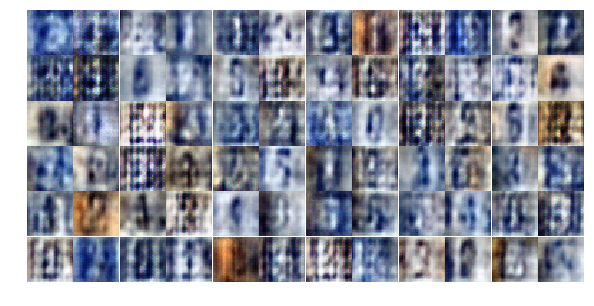

Epoch 5/20... Discriminator Loss: 1.3814... Generator Loss: 0.6867
Epoch 5/20... Discriminator Loss: 1.2933... Generator Loss: 0.7161
Epoch 5/20... Discriminator Loss: 1.3816... Generator Loss: 0.7466
Epoch 5/20... Discriminator Loss: 1.3497... Generator Loss: 0.7529
Epoch 5/20... Discriminator Loss: 1.3592... Generator Loss: 0.8491
Epoch 5/20... Discriminator Loss: 1.3251... Generator Loss: 0.7294
Epoch 5/20... Discriminator Loss: 1.4104... Generator Loss: 0.6762
Epoch 5/20... Discriminator Loss: 1.4014... Generator Loss: 0.7118
Epoch 5/20... Discriminator Loss: 1.3371... Generator Loss: 0.7104
Epoch 5/20... Discriminator Loss: 1.3629... Generator Loss: 0.6718


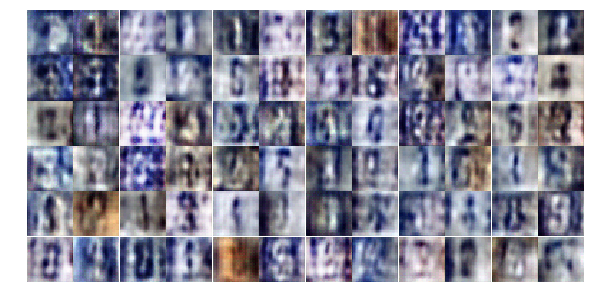

Epoch 5/20... Discriminator Loss: 1.3772... Generator Loss: 0.7640
Epoch 5/20... Discriminator Loss: 1.2978... Generator Loss: 0.7525
Epoch 5/20... Discriminator Loss: 1.2690... Generator Loss: 0.7871
Epoch 5/20... Discriminator Loss: 1.2449... Generator Loss: 0.7824
Epoch 5/20... Discriminator Loss: 1.4222... Generator Loss: 0.6781
Epoch 5/20... Discriminator Loss: 1.2536... Generator Loss: 0.8062
Epoch 5/20... Discriminator Loss: 1.2472... Generator Loss: 0.7939
Epoch 5/20... Discriminator Loss: 1.4218... Generator Loss: 0.6592
Epoch 5/20... Discriminator Loss: 1.2077... Generator Loss: 0.7918
Epoch 5/20... Discriminator Loss: 1.5750... Generator Loss: 0.5950


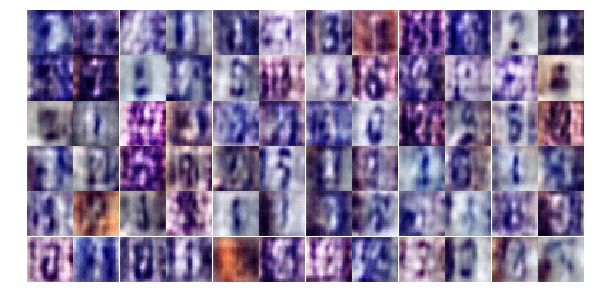

Epoch 5/20... Discriminator Loss: 1.4943... Generator Loss: 0.6793
Epoch 5/20... Discriminator Loss: 1.2288... Generator Loss: 0.7950
Epoch 5/20... Discriminator Loss: 1.3668... Generator Loss: 0.7425
Epoch 5/20... Discriminator Loss: 1.3206... Generator Loss: 0.7229
Epoch 5/20... Discriminator Loss: 1.3642... Generator Loss: 0.6997
Epoch 5/20... Discriminator Loss: 1.3160... Generator Loss: 0.7766
Epoch 5/20... Discriminator Loss: 1.1713... Generator Loss: 0.7611
Epoch 5/20... Discriminator Loss: 1.5316... Generator Loss: 0.6992
Epoch 5/20... Discriminator Loss: 1.2927... Generator Loss: 0.7595
Epoch 5/20... Discriminator Loss: 1.2279... Generator Loss: 0.7739


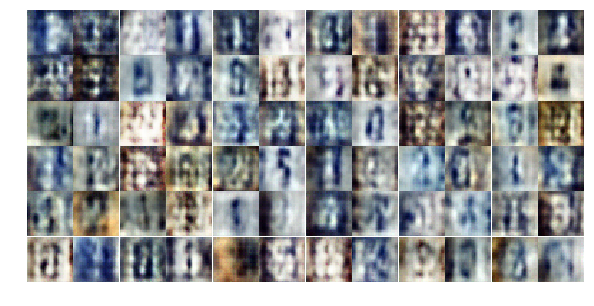

Epoch 5/20... Discriminator Loss: 1.3160... Generator Loss: 0.7621
Epoch 5/20... Discriminator Loss: 1.1895... Generator Loss: 0.7999
Epoch 5/20... Discriminator Loss: 1.3327... Generator Loss: 0.6668
Epoch 5/20... Discriminator Loss: 1.2996... Generator Loss: 0.7133
Epoch 5/20... Discriminator Loss: 1.3705... Generator Loss: 0.7370
Epoch 5/20... Discriminator Loss: 1.5086... Generator Loss: 0.6193
Epoch 5/20... Discriminator Loss: 1.2025... Generator Loss: 0.7968
Epoch 5/20... Discriminator Loss: 1.2783... Generator Loss: 0.8074
Epoch 5/20... Discriminator Loss: 1.3463... Generator Loss: 0.6490
Epoch 5/20... Discriminator Loss: 1.3728... Generator Loss: 0.6748


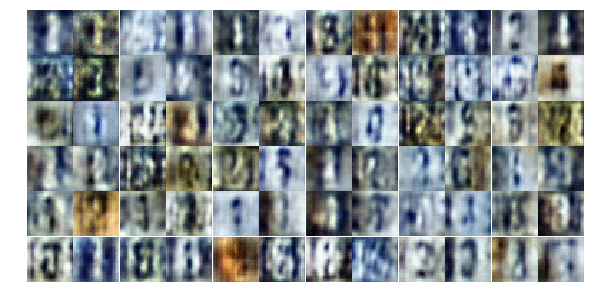

Epoch 5/20... Discriminator Loss: 1.3386... Generator Loss: 0.7645
Epoch 5/20... Discriminator Loss: 1.4160... Generator Loss: 0.7356
Epoch 5/20... Discriminator Loss: 1.1986... Generator Loss: 0.7985
Epoch 5/20... Discriminator Loss: 1.3157... Generator Loss: 0.6590
Epoch 5/20... Discriminator Loss: 1.2148... Generator Loss: 0.7406
Epoch 5/20... Discriminator Loss: 1.3098... Generator Loss: 0.6996
Epoch 6/20... Discriminator Loss: 1.4676... Generator Loss: 0.6661
Epoch 6/20... Discriminator Loss: 1.3960... Generator Loss: 0.7140
Epoch 6/20... Discriminator Loss: 1.2410... Generator Loss: 0.7699
Epoch 6/20... Discriminator Loss: 1.3108... Generator Loss: 0.7273


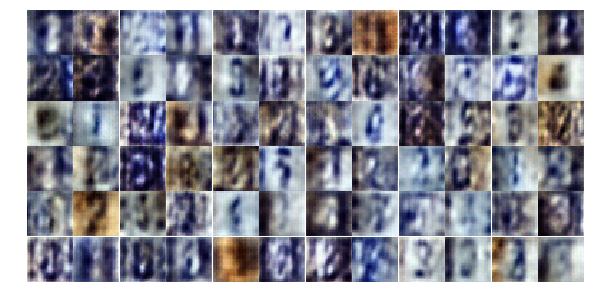

Epoch 6/20... Discriminator Loss: 1.4607... Generator Loss: 0.7604
Epoch 6/20... Discriminator Loss: 1.1850... Generator Loss: 0.7632
Epoch 6/20... Discriminator Loss: 1.2148... Generator Loss: 0.7915
Epoch 6/20... Discriminator Loss: 1.0913... Generator Loss: 0.8761
Epoch 6/20... Discriminator Loss: 1.3241... Generator Loss: 0.7398
Epoch 6/20... Discriminator Loss: 1.1723... Generator Loss: 0.7835
Epoch 6/20... Discriminator Loss: 1.4456... Generator Loss: 0.6372
Epoch 6/20... Discriminator Loss: 1.3261... Generator Loss: 0.7262
Epoch 6/20... Discriminator Loss: 1.1237... Generator Loss: 0.8632
Epoch 6/20... Discriminator Loss: 1.3520... Generator Loss: 0.7305


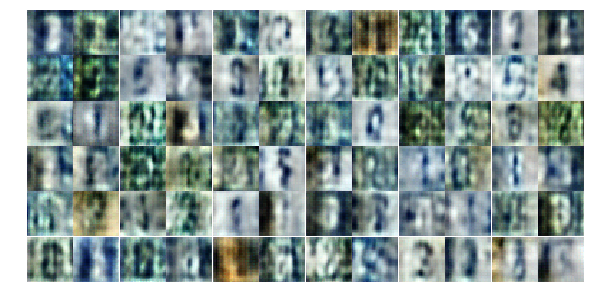

Epoch 6/20... Discriminator Loss: 1.3518... Generator Loss: 0.7039
Epoch 6/20... Discriminator Loss: 1.2776... Generator Loss: 0.6168
Epoch 6/20... Discriminator Loss: 1.3665... Generator Loss: 0.6717
Epoch 6/20... Discriminator Loss: 1.0239... Generator Loss: 1.0149
Epoch 6/20... Discriminator Loss: 1.1017... Generator Loss: 0.8879
Epoch 6/20... Discriminator Loss: 1.2642... Generator Loss: 0.7685
Epoch 6/20... Discriminator Loss: 1.2327... Generator Loss: 0.7330
Epoch 6/20... Discriminator Loss: 1.3444... Generator Loss: 0.6837
Epoch 6/20... Discriminator Loss: 1.1773... Generator Loss: 0.7729
Epoch 6/20... Discriminator Loss: 1.2708... Generator Loss: 0.6615


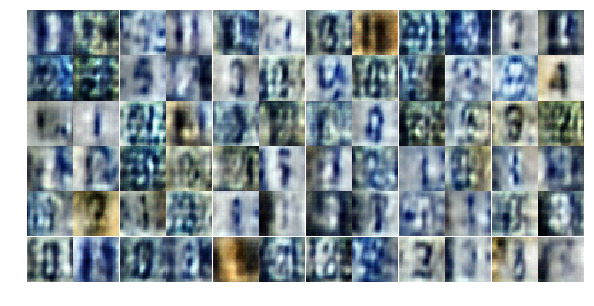

Epoch 6/20... Discriminator Loss: 1.2185... Generator Loss: 0.8603
Epoch 6/20... Discriminator Loss: 1.1513... Generator Loss: 0.8277
Epoch 6/20... Discriminator Loss: 1.3504... Generator Loss: 0.6657
Epoch 6/20... Discriminator Loss: 1.3098... Generator Loss: 0.7002
Epoch 6/20... Discriminator Loss: 1.1680... Generator Loss: 0.9123
Epoch 6/20... Discriminator Loss: 1.3411... Generator Loss: 0.7079
Epoch 6/20... Discriminator Loss: 1.2868... Generator Loss: 0.6956
Epoch 6/20... Discriminator Loss: 1.1598... Generator Loss: 0.8926
Epoch 6/20... Discriminator Loss: 1.1011... Generator Loss: 0.9719
Epoch 6/20... Discriminator Loss: 1.0673... Generator Loss: 0.9869


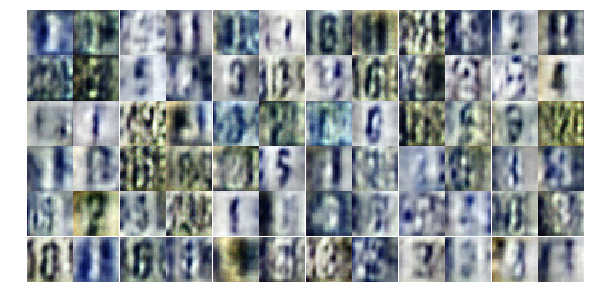

Epoch 6/20... Discriminator Loss: 1.1443... Generator Loss: 0.7226
Epoch 6/20... Discriminator Loss: 1.1896... Generator Loss: 1.0233
Epoch 6/20... Discriminator Loss: 1.1353... Generator Loss: 0.8762
Epoch 6/20... Discriminator Loss: 1.0209... Generator Loss: 1.3383
Epoch 6/20... Discriminator Loss: 0.9652... Generator Loss: 0.9674
Epoch 6/20... Discriminator Loss: 1.5853... Generator Loss: 0.6638
Epoch 6/20... Discriminator Loss: 1.3675... Generator Loss: 0.7003
Epoch 6/20... Discriminator Loss: 1.4198... Generator Loss: 0.7518
Epoch 6/20... Discriminator Loss: 1.3134... Generator Loss: 0.7624
Epoch 6/20... Discriminator Loss: 0.9205... Generator Loss: 0.9796


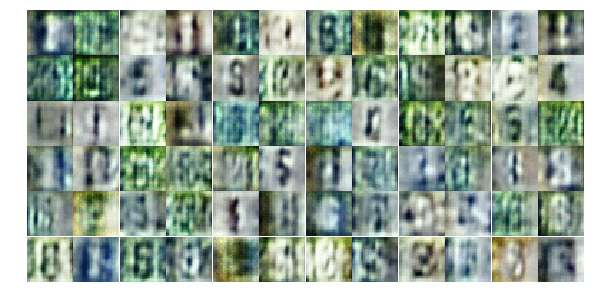

Epoch 6/20... Discriminator Loss: 1.1117... Generator Loss: 0.8825
Epoch 6/20... Discriminator Loss: 1.1639... Generator Loss: 0.9561
Epoch 6/20... Discriminator Loss: 1.1782... Generator Loss: 0.7429
Epoch 6/20... Discriminator Loss: 1.0757... Generator Loss: 0.8701
Epoch 6/20... Discriminator Loss: 1.0391... Generator Loss: 0.7498
Epoch 6/20... Discriminator Loss: 1.1679... Generator Loss: 0.7964
Epoch 6/20... Discriminator Loss: 1.0066... Generator Loss: 0.9931
Epoch 6/20... Discriminator Loss: 1.0256... Generator Loss: 0.8159
Epoch 6/20... Discriminator Loss: 1.1627... Generator Loss: 0.7898
Epoch 6/20... Discriminator Loss: 1.3508... Generator Loss: 0.5660


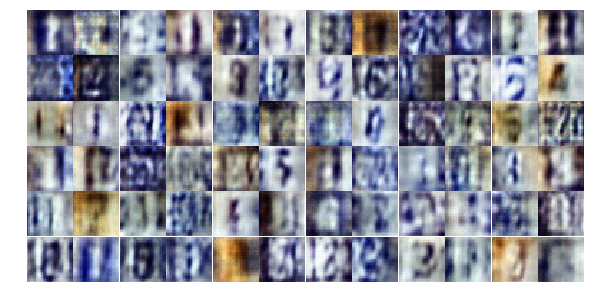

Epoch 6/20... Discriminator Loss: 1.1699... Generator Loss: 0.6450
Epoch 6/20... Discriminator Loss: 0.9281... Generator Loss: 0.9737
Epoch 6/20... Discriminator Loss: 1.2230... Generator Loss: 0.7899
Epoch 7/20... Discriminator Loss: 0.9588... Generator Loss: 0.9534
Epoch 7/20... Discriminator Loss: 0.6977... Generator Loss: 1.3252
Epoch 7/20... Discriminator Loss: 1.1445... Generator Loss: 0.8628
Epoch 7/20... Discriminator Loss: 1.1938... Generator Loss: 0.8744
Epoch 7/20... Discriminator Loss: 1.1469... Generator Loss: 0.7159
Epoch 7/20... Discriminator Loss: 1.1716... Generator Loss: 0.9529
Epoch 7/20... Discriminator Loss: 1.0980... Generator Loss: 0.6262


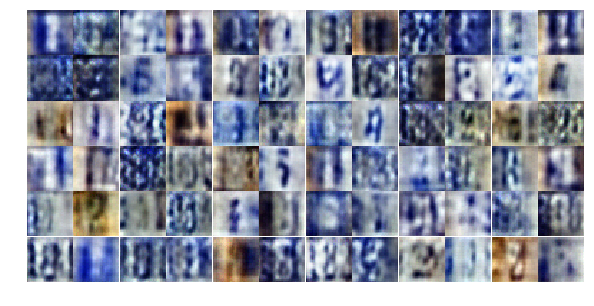

Epoch 7/20... Discriminator Loss: 1.3002... Generator Loss: 0.6373
Epoch 7/20... Discriminator Loss: 0.8194... Generator Loss: 1.6001
Epoch 7/20... Discriminator Loss: 1.3200... Generator Loss: 0.9100
Epoch 7/20... Discriminator Loss: 1.2750... Generator Loss: 0.6597
Epoch 7/20... Discriminator Loss: 1.1346... Generator Loss: 0.8110
Epoch 7/20... Discriminator Loss: 1.2060... Generator Loss: 0.8528
Epoch 7/20... Discriminator Loss: 1.0357... Generator Loss: 1.1536
Epoch 7/20... Discriminator Loss: 0.9005... Generator Loss: 1.2705
Epoch 7/20... Discriminator Loss: 1.0301... Generator Loss: 1.0239
Epoch 7/20... Discriminator Loss: 0.9595... Generator Loss: 1.1815


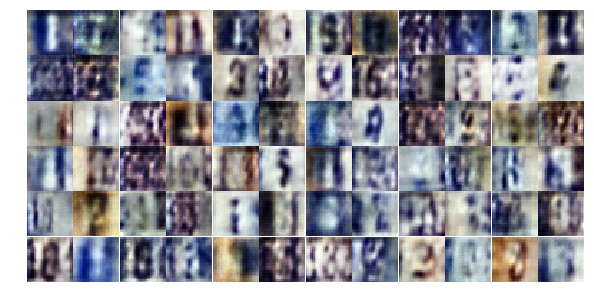

Epoch 7/20... Discriminator Loss: 1.0447... Generator Loss: 1.1537
Epoch 7/20... Discriminator Loss: 1.1332... Generator Loss: 0.9464
Epoch 7/20... Discriminator Loss: 1.0894... Generator Loss: 0.8105
Epoch 7/20... Discriminator Loss: 0.9564... Generator Loss: 1.2662
Epoch 7/20... Discriminator Loss: 1.0467... Generator Loss: 0.7823
Epoch 7/20... Discriminator Loss: 1.1481... Generator Loss: 1.0403
Epoch 7/20... Discriminator Loss: 0.8613... Generator Loss: 0.9292
Epoch 7/20... Discriminator Loss: 1.2559... Generator Loss: 0.4907
Epoch 7/20... Discriminator Loss: 1.1764... Generator Loss: 0.8614
Epoch 7/20... Discriminator Loss: 1.1251... Generator Loss: 0.8663


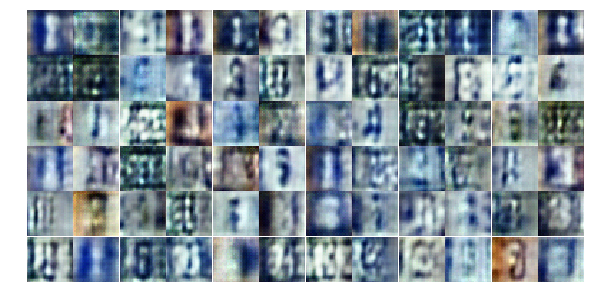

Epoch 7/20... Discriminator Loss: 0.8368... Generator Loss: 1.2051
Epoch 7/20... Discriminator Loss: 1.0095... Generator Loss: 0.9181
Epoch 7/20... Discriminator Loss: 1.0231... Generator Loss: 1.0919
Epoch 7/20... Discriminator Loss: 0.9926... Generator Loss: 0.7820
Epoch 7/20... Discriminator Loss: 0.9885... Generator Loss: 0.9736
Epoch 7/20... Discriminator Loss: 1.0803... Generator Loss: 0.8062
Epoch 7/20... Discriminator Loss: 0.9102... Generator Loss: 0.9587
Epoch 7/20... Discriminator Loss: 1.0811... Generator Loss: 0.8944
Epoch 7/20... Discriminator Loss: 0.9986... Generator Loss: 1.0828
Epoch 7/20... Discriminator Loss: 0.9706... Generator Loss: 1.1700


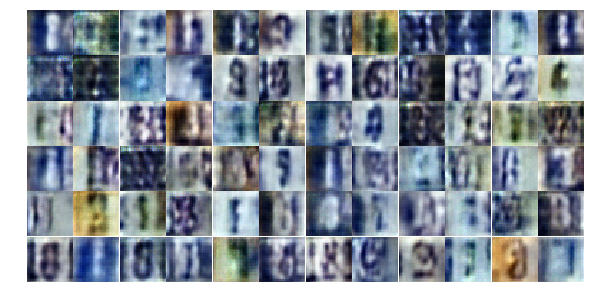

Epoch 7/20... Discriminator Loss: 1.0324... Generator Loss: 0.9688
Epoch 7/20... Discriminator Loss: 0.7729... Generator Loss: 1.2672
Epoch 7/20... Discriminator Loss: 1.0556... Generator Loss: 0.7308
Epoch 7/20... Discriminator Loss: 1.1335... Generator Loss: 0.8586
Epoch 7/20... Discriminator Loss: 1.0515... Generator Loss: 0.9000
Epoch 7/20... Discriminator Loss: 0.9586... Generator Loss: 0.8320
Epoch 7/20... Discriminator Loss: 1.1482... Generator Loss: 0.6079
Epoch 7/20... Discriminator Loss: 1.3222... Generator Loss: 0.7427
Epoch 7/20... Discriminator Loss: 0.9903... Generator Loss: 1.2513
Epoch 7/20... Discriminator Loss: 0.7406... Generator Loss: 1.8637


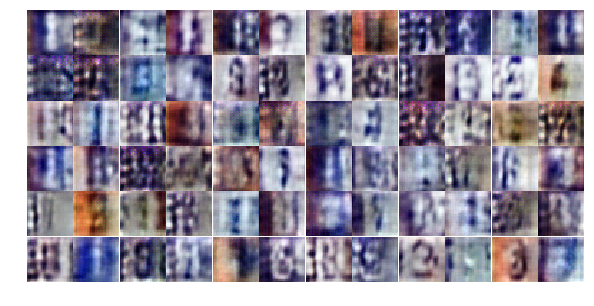

Epoch 7/20... Discriminator Loss: 0.9939... Generator Loss: 0.9594
Epoch 7/20... Discriminator Loss: 1.2201... Generator Loss: 0.5966
Epoch 7/20... Discriminator Loss: 1.0910... Generator Loss: 0.8230
Epoch 7/20... Discriminator Loss: 0.8920... Generator Loss: 0.8733
Epoch 7/20... Discriminator Loss: 0.9406... Generator Loss: 0.9262
Epoch 7/20... Discriminator Loss: 1.0793... Generator Loss: 0.7778
Epoch 7/20... Discriminator Loss: 0.9355... Generator Loss: 0.8780
Epoch 7/20... Discriminator Loss: 1.2203... Generator Loss: 0.8754
Epoch 7/20... Discriminator Loss: 1.0547... Generator Loss: 0.8295
Epoch 7/20... Discriminator Loss: 0.8341... Generator Loss: 1.0498


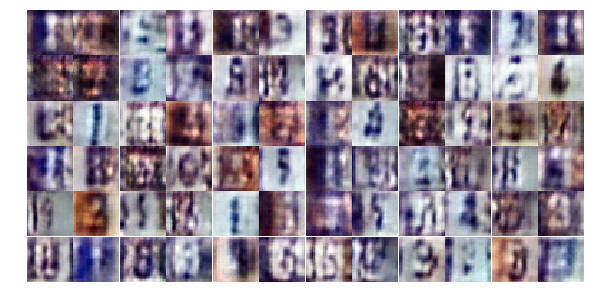

Epoch 7/20... Discriminator Loss: 1.0464... Generator Loss: 1.2514
Epoch 8/20... Discriminator Loss: 1.0515... Generator Loss: 0.8735
Epoch 8/20... Discriminator Loss: 1.0383... Generator Loss: 0.7887
Epoch 8/20... Discriminator Loss: 1.0426... Generator Loss: 0.8652
Epoch 8/20... Discriminator Loss: 1.0154... Generator Loss: 0.8099
Epoch 8/20... Discriminator Loss: 1.1602... Generator Loss: 0.9560
Epoch 8/20... Discriminator Loss: 1.0710... Generator Loss: 0.7095
Epoch 8/20... Discriminator Loss: 1.0573... Generator Loss: 1.4155
Epoch 8/20... Discriminator Loss: 1.1987... Generator Loss: 0.7850
Epoch 8/20... Discriminator Loss: 1.0926... Generator Loss: 0.8607


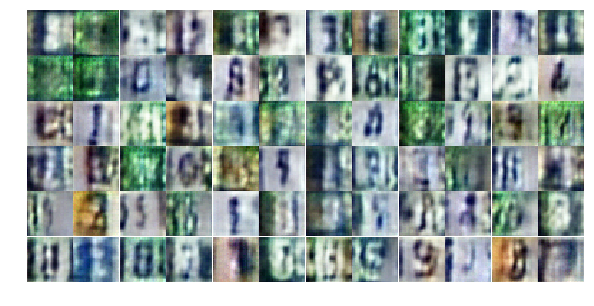

Epoch 8/20... Discriminator Loss: 0.7835... Generator Loss: 1.6772
Epoch 8/20... Discriminator Loss: 1.1560... Generator Loss: 1.4108
Epoch 8/20... Discriminator Loss: 1.0670... Generator Loss: 1.1931
Epoch 8/20... Discriminator Loss: 0.9150... Generator Loss: 1.1498
Epoch 8/20... Discriminator Loss: 0.9907... Generator Loss: 0.9386
Epoch 8/20... Discriminator Loss: 1.2067... Generator Loss: 1.0647
Epoch 8/20... Discriminator Loss: 1.1003... Generator Loss: 0.9647
Epoch 8/20... Discriminator Loss: 0.9707... Generator Loss: 1.1820
Epoch 8/20... Discriminator Loss: 1.0391... Generator Loss: 0.8728
Epoch 8/20... Discriminator Loss: 1.4839... Generator Loss: 0.4206


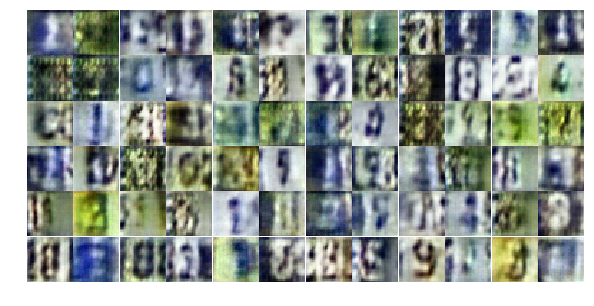

Epoch 8/20... Discriminator Loss: 0.9039... Generator Loss: 1.0243
Epoch 8/20... Discriminator Loss: 0.9659... Generator Loss: 0.9951
Epoch 8/20... Discriminator Loss: 1.0966... Generator Loss: 1.1514
Epoch 8/20... Discriminator Loss: 1.0732... Generator Loss: 1.0976
Epoch 8/20... Discriminator Loss: 1.0205... Generator Loss: 1.1028
Epoch 8/20... Discriminator Loss: 1.0986... Generator Loss: 0.7681
Epoch 8/20... Discriminator Loss: 1.1700... Generator Loss: 0.8135
Epoch 8/20... Discriminator Loss: 1.1021... Generator Loss: 0.7705
Epoch 8/20... Discriminator Loss: 1.1827... Generator Loss: 0.9881
Epoch 8/20... Discriminator Loss: 1.0981... Generator Loss: 0.8536


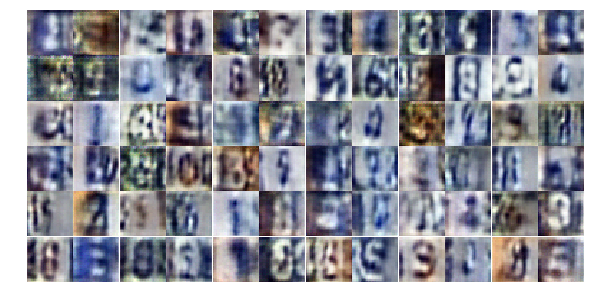

Epoch 8/20... Discriminator Loss: 1.0114... Generator Loss: 0.9095
Epoch 8/20... Discriminator Loss: 1.2840... Generator Loss: 0.6161
Epoch 8/20... Discriminator Loss: 1.1389... Generator Loss: 0.5805
Epoch 8/20... Discriminator Loss: 1.1879... Generator Loss: 0.9136
Epoch 8/20... Discriminator Loss: 1.0834... Generator Loss: 0.7634
Epoch 8/20... Discriminator Loss: 1.0509... Generator Loss: 0.9652
Epoch 8/20... Discriminator Loss: 1.1476... Generator Loss: 0.8481
Epoch 8/20... Discriminator Loss: 1.0092... Generator Loss: 1.1019
Epoch 8/20... Discriminator Loss: 1.0542... Generator Loss: 0.8888
Epoch 8/20... Discriminator Loss: 0.9281... Generator Loss: 1.0262


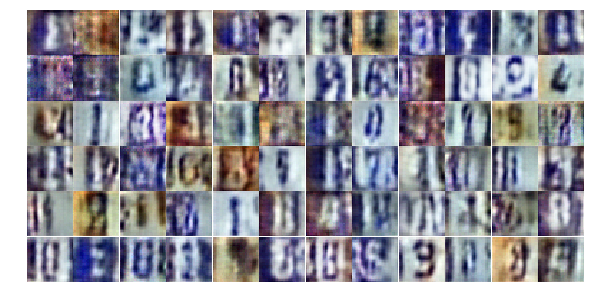

Epoch 8/20... Discriminator Loss: 1.0454... Generator Loss: 1.3066
Epoch 8/20... Discriminator Loss: 0.9859... Generator Loss: 0.9663
Epoch 8/20... Discriminator Loss: 0.9183... Generator Loss: 1.1533
Epoch 8/20... Discriminator Loss: 1.0424... Generator Loss: 1.1588
Epoch 8/20... Discriminator Loss: 1.9393... Generator Loss: 1.9870
Epoch 8/20... Discriminator Loss: 1.1272... Generator Loss: 0.6120
Epoch 8/20... Discriminator Loss: 1.0596... Generator Loss: 1.0916
Epoch 8/20... Discriminator Loss: 1.1764... Generator Loss: 0.7664
Epoch 8/20... Discriminator Loss: 1.1174... Generator Loss: 0.8411
Epoch 8/20... Discriminator Loss: 1.0893... Generator Loss: 1.0237


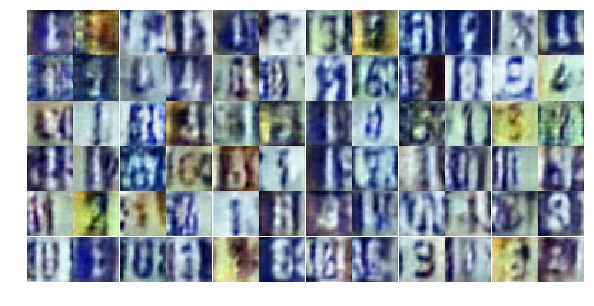

Epoch 8/20... Discriminator Loss: 0.9472... Generator Loss: 1.1244
Epoch 8/20... Discriminator Loss: 1.0352... Generator Loss: 1.0450
Epoch 8/20... Discriminator Loss: 1.0797... Generator Loss: 0.9788
Epoch 8/20... Discriminator Loss: 1.1321... Generator Loss: 0.6002
Epoch 8/20... Discriminator Loss: 0.8487... Generator Loss: 1.2427
Epoch 8/20... Discriminator Loss: 1.2377... Generator Loss: 0.9351
Epoch 8/20... Discriminator Loss: 1.0391... Generator Loss: 1.0531
Epoch 8/20... Discriminator Loss: 1.2306... Generator Loss: 1.0173
Epoch 9/20... Discriminator Loss: 1.2361... Generator Loss: 0.6144
Epoch 9/20... Discriminator Loss: 1.1924... Generator Loss: 0.5799


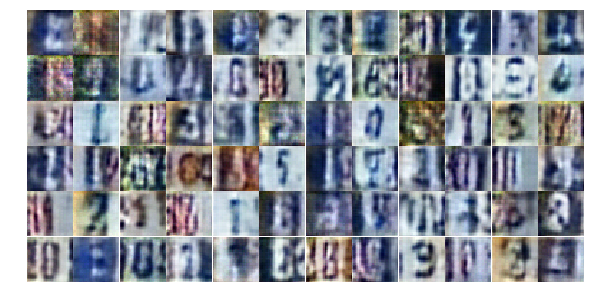

Epoch 9/20... Discriminator Loss: 1.0686... Generator Loss: 0.8835
Epoch 9/20... Discriminator Loss: 1.2156... Generator Loss: 0.6343
Epoch 9/20... Discriminator Loss: 1.0410... Generator Loss: 0.8386
Epoch 9/20... Discriminator Loss: 1.0951... Generator Loss: 0.8002
Epoch 9/20... Discriminator Loss: 1.1347... Generator Loss: 0.7805
Epoch 9/20... Discriminator Loss: 1.0846... Generator Loss: 0.9881
Epoch 9/20... Discriminator Loss: 1.1312... Generator Loss: 0.6645
Epoch 9/20... Discriminator Loss: 1.0144... Generator Loss: 1.0353
Epoch 9/20... Discriminator Loss: 1.1330... Generator Loss: 0.9447
Epoch 9/20... Discriminator Loss: 1.0874... Generator Loss: 0.8511


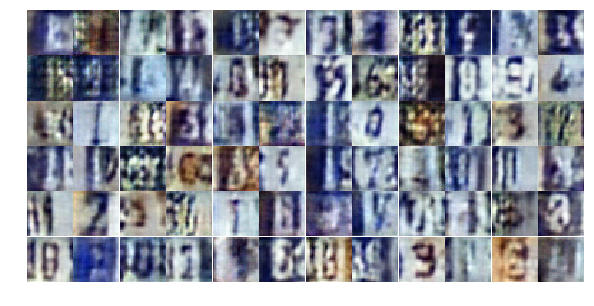

Epoch 9/20... Discriminator Loss: 1.1316... Generator Loss: 0.7516
Epoch 9/20... Discriminator Loss: 1.1241... Generator Loss: 0.8425
Epoch 9/20... Discriminator Loss: 1.0249... Generator Loss: 0.8733
Epoch 9/20... Discriminator Loss: 0.8881... Generator Loss: 0.9718
Epoch 9/20... Discriminator Loss: 1.1458... Generator Loss: 0.9247
Epoch 9/20... Discriminator Loss: 1.2349... Generator Loss: 0.9023
Epoch 9/20... Discriminator Loss: 1.2890... Generator Loss: 0.5817
Epoch 9/20... Discriminator Loss: 1.2045... Generator Loss: 0.7449
Epoch 9/20... Discriminator Loss: 1.2144... Generator Loss: 0.7446
Epoch 9/20... Discriminator Loss: 1.1129... Generator Loss: 0.7232


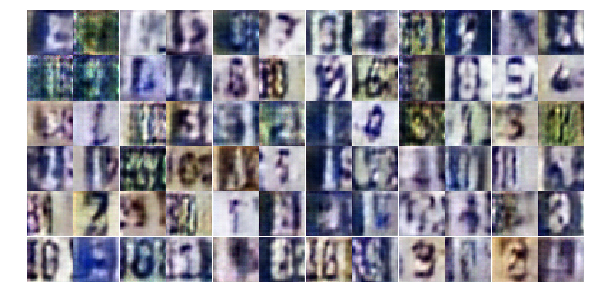

Epoch 9/20... Discriminator Loss: 1.2234... Generator Loss: 0.7155
Epoch 9/20... Discriminator Loss: 1.0543... Generator Loss: 0.9013
Epoch 9/20... Discriminator Loss: 1.0504... Generator Loss: 0.9176
Epoch 9/20... Discriminator Loss: 1.0075... Generator Loss: 0.9153
Epoch 9/20... Discriminator Loss: 0.9654... Generator Loss: 0.8566
Epoch 9/20... Discriminator Loss: 1.0652... Generator Loss: 0.7533
Epoch 9/20... Discriminator Loss: 1.1417... Generator Loss: 0.7957
Epoch 9/20... Discriminator Loss: 1.0101... Generator Loss: 1.1086
Epoch 9/20... Discriminator Loss: 1.2105... Generator Loss: 0.7621
Epoch 9/20... Discriminator Loss: 1.1236... Generator Loss: 0.7111


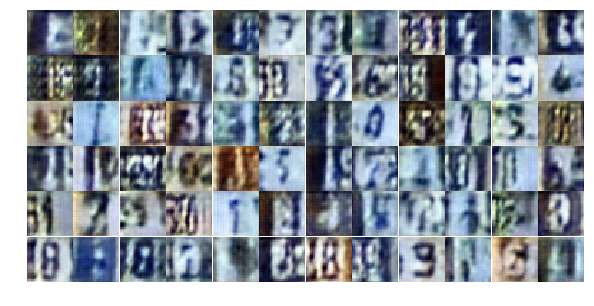

Epoch 9/20... Discriminator Loss: 0.9103... Generator Loss: 1.0590
Epoch 9/20... Discriminator Loss: 1.1454... Generator Loss: 0.6153
Epoch 9/20... Discriminator Loss: 1.1618... Generator Loss: 0.6806
Epoch 9/20... Discriminator Loss: 1.3844... Generator Loss: 0.6209
Epoch 9/20... Discriminator Loss: 1.1499... Generator Loss: 0.8454
Epoch 9/20... Discriminator Loss: 1.2659... Generator Loss: 0.7205
Epoch 9/20... Discriminator Loss: 1.0214... Generator Loss: 0.8005
Epoch 9/20... Discriminator Loss: 0.8466... Generator Loss: 1.0345
Epoch 9/20... Discriminator Loss: 1.0867... Generator Loss: 0.6992
Epoch 9/20... Discriminator Loss: 1.1590... Generator Loss: 0.6199


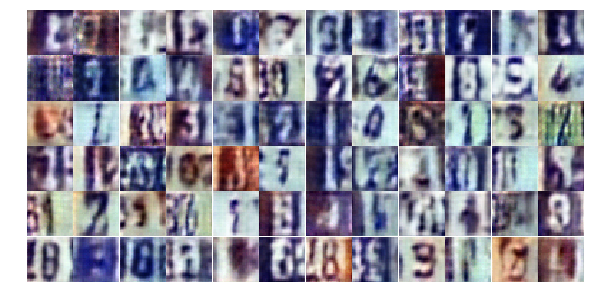

Epoch 9/20... Discriminator Loss: 1.1241... Generator Loss: 0.8298
Epoch 9/20... Discriminator Loss: 1.0792... Generator Loss: 0.7780
Epoch 9/20... Discriminator Loss: 1.0662... Generator Loss: 1.2052
Epoch 9/20... Discriminator Loss: 1.2582... Generator Loss: 0.6401
Epoch 9/20... Discriminator Loss: 1.0429... Generator Loss: 0.7887
Epoch 9/20... Discriminator Loss: 1.1082... Generator Loss: 0.7812
Epoch 9/20... Discriminator Loss: 1.1538... Generator Loss: 0.7927
Epoch 9/20... Discriminator Loss: 1.2107... Generator Loss: 0.6913
Epoch 9/20... Discriminator Loss: 0.8425... Generator Loss: 1.3209
Epoch 9/20... Discriminator Loss: 1.2041... Generator Loss: 0.9233


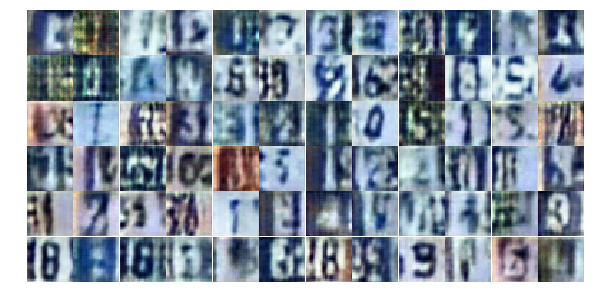

Epoch 9/20... Discriminator Loss: 1.0956... Generator Loss: 0.8617
Epoch 9/20... Discriminator Loss: 1.2239... Generator Loss: 1.2029
Epoch 9/20... Discriminator Loss: 0.8827... Generator Loss: 0.8733
Epoch 9/20... Discriminator Loss: 1.1439... Generator Loss: 0.6270
Epoch 9/20... Discriminator Loss: 1.0105... Generator Loss: 1.0751
Epoch 10/20... Discriminator Loss: 1.1296... Generator Loss: 0.7437
Epoch 10/20... Discriminator Loss: 1.0683... Generator Loss: 0.7598
Epoch 10/20... Discriminator Loss: 1.2799... Generator Loss: 0.5752
Epoch 10/20... Discriminator Loss: 1.1575... Generator Loss: 0.7109
Epoch 10/20... Discriminator Loss: 1.2039... Generator Loss: 0.6014


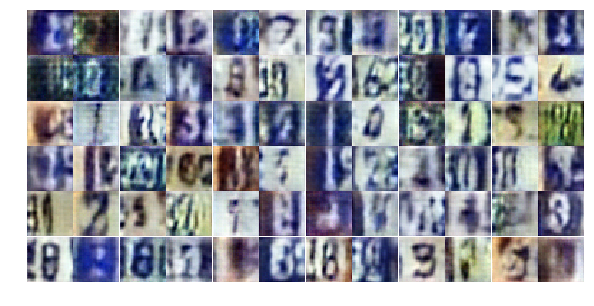

Epoch 10/20... Discriminator Loss: 1.0275... Generator Loss: 0.9569
Epoch 10/20... Discriminator Loss: 0.9851... Generator Loss: 0.8227
Epoch 10/20... Discriminator Loss: 1.0090... Generator Loss: 0.9441
Epoch 10/20... Discriminator Loss: 1.0301... Generator Loss: 0.9115
Epoch 10/20... Discriminator Loss: 0.9555... Generator Loss: 0.9638
Epoch 10/20... Discriminator Loss: 1.0542... Generator Loss: 0.9489
Epoch 10/20... Discriminator Loss: 1.2609... Generator Loss: 1.6903
Epoch 10/20... Discriminator Loss: 1.0699... Generator Loss: 0.7523
Epoch 10/20... Discriminator Loss: 1.1326... Generator Loss: 0.6403
Epoch 10/20... Discriminator Loss: 0.9739... Generator Loss: 0.9584


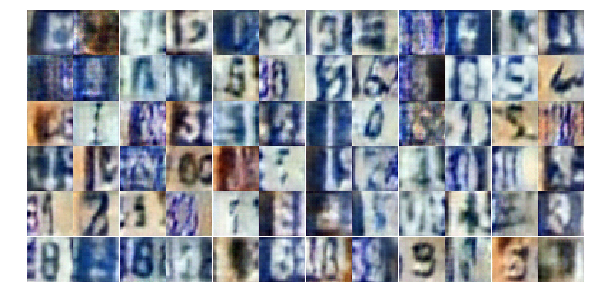

Epoch 10/20... Discriminator Loss: 1.0190... Generator Loss: 0.9557
Epoch 10/20... Discriminator Loss: 1.1507... Generator Loss: 0.6041
Epoch 10/20... Discriminator Loss: 1.1399... Generator Loss: 0.7433
Epoch 10/20... Discriminator Loss: 1.2876... Generator Loss: 0.5131
Epoch 10/20... Discriminator Loss: 1.0850... Generator Loss: 0.9408
Epoch 10/20... Discriminator Loss: 1.0854... Generator Loss: 0.7990
Epoch 10/20... Discriminator Loss: 1.1618... Generator Loss: 0.6513
Epoch 10/20... Discriminator Loss: 1.2394... Generator Loss: 0.5320
Epoch 10/20... Discriminator Loss: 1.0352... Generator Loss: 0.8809
Epoch 10/20... Discriminator Loss: 1.0616... Generator Loss: 0.8930


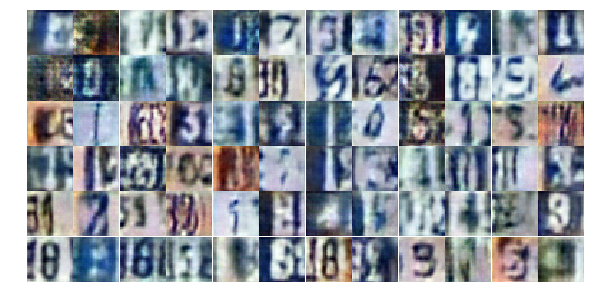

Epoch 10/20... Discriminator Loss: 0.9621... Generator Loss: 0.8199
Epoch 10/20... Discriminator Loss: 1.1175... Generator Loss: 0.7214
Epoch 10/20... Discriminator Loss: 0.6475... Generator Loss: 1.5174
Epoch 10/20... Discriminator Loss: 0.8906... Generator Loss: 1.0388
Epoch 10/20... Discriminator Loss: 1.0487... Generator Loss: 0.7076
Epoch 10/20... Discriminator Loss: 1.1601... Generator Loss: 0.6300
Epoch 10/20... Discriminator Loss: 0.7649... Generator Loss: 1.2486
Epoch 10/20... Discriminator Loss: 0.9745... Generator Loss: 0.8377
Epoch 10/20... Discriminator Loss: 0.9299... Generator Loss: 0.8375
Epoch 10/20... Discriminator Loss: 0.9339... Generator Loss: 0.9777


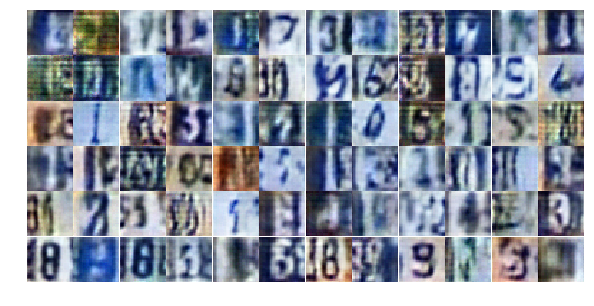

Epoch 10/20... Discriminator Loss: 0.9777... Generator Loss: 1.1125
Epoch 10/20... Discriminator Loss: 1.1181... Generator Loss: 0.7076
Epoch 10/20... Discriminator Loss: 0.9322... Generator Loss: 0.8681
Epoch 10/20... Discriminator Loss: 1.1130... Generator Loss: 0.8960
Epoch 10/20... Discriminator Loss: 1.0131... Generator Loss: 0.7038
Epoch 10/20... Discriminator Loss: 1.2089... Generator Loss: 0.5943
Epoch 10/20... Discriminator Loss: 0.8877... Generator Loss: 0.9377
Epoch 10/20... Discriminator Loss: 1.2795... Generator Loss: 0.5950
Epoch 10/20... Discriminator Loss: 0.8657... Generator Loss: 1.3081
Epoch 10/20... Discriminator Loss: 1.2959... Generator Loss: 1.3155


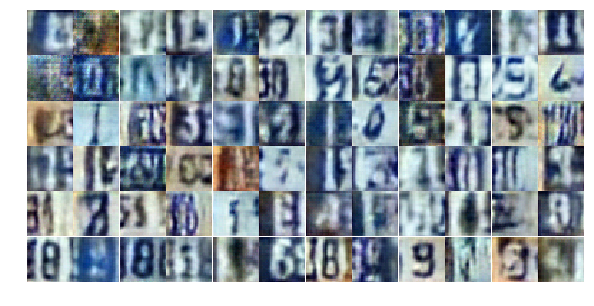

Epoch 10/20... Discriminator Loss: 1.1012... Generator Loss: 0.6444
Epoch 10/20... Discriminator Loss: 1.1156... Generator Loss: 0.8170
Epoch 10/20... Discriminator Loss: 0.9488... Generator Loss: 0.8518
Epoch 10/20... Discriminator Loss: 0.8767... Generator Loss: 0.9002
Epoch 10/20... Discriminator Loss: 0.9521... Generator Loss: 1.1168
Epoch 10/20... Discriminator Loss: 1.1109... Generator Loss: 1.1969
Epoch 10/20... Discriminator Loss: 1.0708... Generator Loss: 0.8766
Epoch 10/20... Discriminator Loss: 0.8933... Generator Loss: 0.9159
Epoch 10/20... Discriminator Loss: 1.1341... Generator Loss: 0.7504
Epoch 10/20... Discriminator Loss: 1.0121... Generator Loss: 0.7923


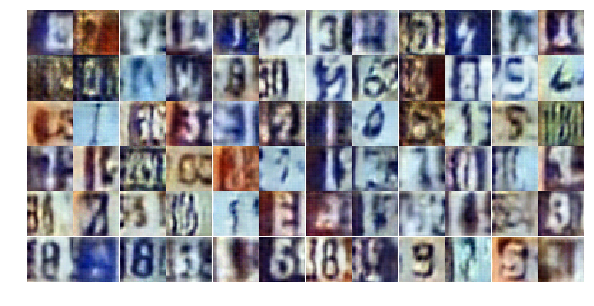

Epoch 10/20... Discriminator Loss: 1.2414... Generator Loss: 0.7970
Epoch 10/20... Discriminator Loss: 0.9572... Generator Loss: 1.2725
Epoch 10/20... Discriminator Loss: 0.8392... Generator Loss: 0.7806
Epoch 11/20... Discriminator Loss: 1.1990... Generator Loss: 0.6677
Epoch 11/20... Discriminator Loss: 1.0089... Generator Loss: 1.0262
Epoch 11/20... Discriminator Loss: 1.3068... Generator Loss: 0.4306
Epoch 11/20... Discriminator Loss: 1.0714... Generator Loss: 0.8228
Epoch 11/20... Discriminator Loss: 1.0683... Generator Loss: 0.8694
Epoch 11/20... Discriminator Loss: 1.1609... Generator Loss: 0.7062
Epoch 11/20... Discriminator Loss: 1.0347... Generator Loss: 0.8718


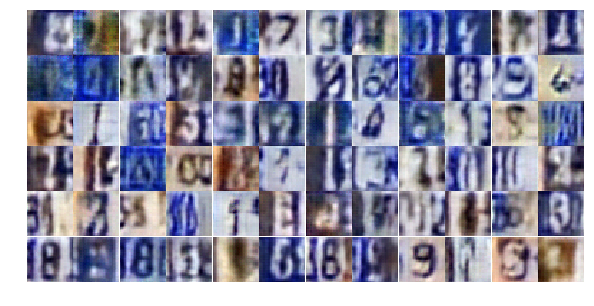

Epoch 11/20... Discriminator Loss: 0.9150... Generator Loss: 0.9131
Epoch 11/20... Discriminator Loss: 1.0812... Generator Loss: 0.7231
Epoch 11/20... Discriminator Loss: 1.0654... Generator Loss: 0.7667
Epoch 11/20... Discriminator Loss: 0.9945... Generator Loss: 0.8797
Epoch 11/20... Discriminator Loss: 1.0812... Generator Loss: 0.8376
Epoch 11/20... Discriminator Loss: 1.0722... Generator Loss: 0.6619
Epoch 11/20... Discriminator Loss: 0.9255... Generator Loss: 1.1965
Epoch 11/20... Discriminator Loss: 0.8506... Generator Loss: 1.0806
Epoch 11/20... Discriminator Loss: 0.9528... Generator Loss: 0.7547
Epoch 11/20... Discriminator Loss: 1.2051... Generator Loss: 0.6015


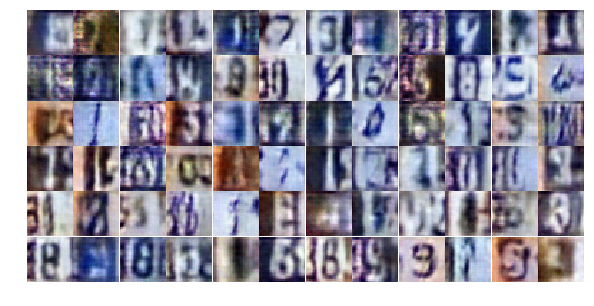

Epoch 11/20... Discriminator Loss: 1.3051... Generator Loss: 0.5208
Epoch 11/20... Discriminator Loss: 0.5679... Generator Loss: 1.5983
Epoch 11/20... Discriminator Loss: 1.3536... Generator Loss: 0.5118
Epoch 11/20... Discriminator Loss: 0.8958... Generator Loss: 0.8639
Epoch 11/20... Discriminator Loss: 0.9685... Generator Loss: 0.9411
Epoch 11/20... Discriminator Loss: 0.9322... Generator Loss: 1.0426
Epoch 11/20... Discriminator Loss: 1.1148... Generator Loss: 0.7758
Epoch 11/20... Discriminator Loss: 1.2108... Generator Loss: 0.6742
Epoch 11/20... Discriminator Loss: 1.0151... Generator Loss: 0.9003
Epoch 11/20... Discriminator Loss: 0.6086... Generator Loss: 1.2640


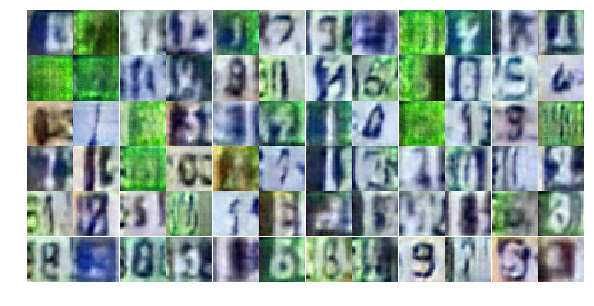

Epoch 11/20... Discriminator Loss: 1.0682... Generator Loss: 0.9684
Epoch 11/20... Discriminator Loss: 0.9995... Generator Loss: 0.7981
Epoch 11/20... Discriminator Loss: 1.1115... Generator Loss: 1.0094
Epoch 11/20... Discriminator Loss: 0.9407... Generator Loss: 0.8630
Epoch 11/20... Discriminator Loss: 1.0584... Generator Loss: 0.8194
Epoch 11/20... Discriminator Loss: 1.0759... Generator Loss: 0.6618
Epoch 11/20... Discriminator Loss: 1.2642... Generator Loss: 0.6167
Epoch 11/20... Discriminator Loss: 1.2295... Generator Loss: 0.6412
Epoch 11/20... Discriminator Loss: 0.9706... Generator Loss: 0.9374
Epoch 11/20... Discriminator Loss: 1.1825... Generator Loss: 0.5831


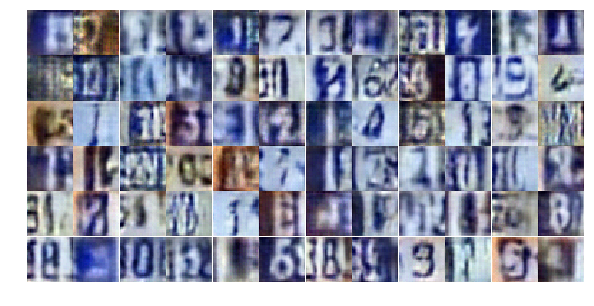

Epoch 11/20... Discriminator Loss: 0.9983... Generator Loss: 0.9949
Epoch 11/20... Discriminator Loss: 0.8448... Generator Loss: 1.0284
Epoch 11/20... Discriminator Loss: 0.9990... Generator Loss: 1.0448
Epoch 11/20... Discriminator Loss: 1.0898... Generator Loss: 0.9043
Epoch 11/20... Discriminator Loss: 1.0482... Generator Loss: 0.8039
Epoch 11/20... Discriminator Loss: 0.8148... Generator Loss: 1.0346
Epoch 11/20... Discriminator Loss: 1.0253... Generator Loss: 0.9890
Epoch 11/20... Discriminator Loss: 1.1459... Generator Loss: 0.7199
Epoch 11/20... Discriminator Loss: 1.1146... Generator Loss: 0.6830
Epoch 11/20... Discriminator Loss: 1.0737... Generator Loss: 0.6823


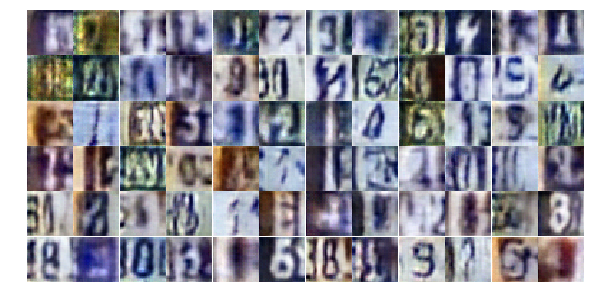

Epoch 11/20... Discriminator Loss: 1.0192... Generator Loss: 0.9138
Epoch 11/20... Discriminator Loss: 1.0343... Generator Loss: 0.8804
Epoch 11/20... Discriminator Loss: 1.1876... Generator Loss: 0.6001
Epoch 11/20... Discriminator Loss: 0.9628... Generator Loss: 0.7588
Epoch 11/20... Discriminator Loss: 1.1352... Generator Loss: 0.5725
Epoch 11/20... Discriminator Loss: 0.9864... Generator Loss: 0.8229
Epoch 11/20... Discriminator Loss: 1.3100... Generator Loss: 0.5220
Epoch 11/20... Discriminator Loss: 1.0687... Generator Loss: 1.0180
Epoch 11/20... Discriminator Loss: 1.4682... Generator Loss: 0.4342
Epoch 11/20... Discriminator Loss: 1.1297... Generator Loss: 0.6063


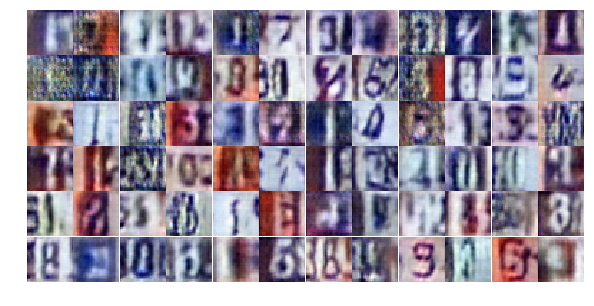

Epoch 12/20... Discriminator Loss: 1.0931... Generator Loss: 0.9220
Epoch 12/20... Discriminator Loss: 1.1044... Generator Loss: 0.7475
Epoch 12/20... Discriminator Loss: 1.2388... Generator Loss: 0.5839
Epoch 12/20... Discriminator Loss: 0.9521... Generator Loss: 0.8434
Epoch 12/20... Discriminator Loss: 0.8930... Generator Loss: 0.9409
Epoch 12/20... Discriminator Loss: 1.1136... Generator Loss: 0.6504
Epoch 12/20... Discriminator Loss: 0.9733... Generator Loss: 1.2881
Epoch 12/20... Discriminator Loss: 0.9324... Generator Loss: 0.9091
Epoch 12/20... Discriminator Loss: 0.9635... Generator Loss: 0.8382
Epoch 12/20... Discriminator Loss: 0.9821... Generator Loss: 0.8735


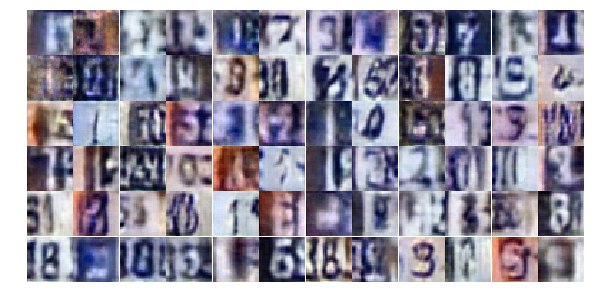

Epoch 12/20... Discriminator Loss: 1.6052... Generator Loss: 0.7346
Epoch 12/20... Discriminator Loss: 1.0297... Generator Loss: 0.7906
Epoch 12/20... Discriminator Loss: 0.9405... Generator Loss: 0.7315
Epoch 12/20... Discriminator Loss: 1.3294... Generator Loss: 0.5619
Epoch 12/20... Discriminator Loss: 0.8608... Generator Loss: 0.9609
Epoch 12/20... Discriminator Loss: 1.4010... Generator Loss: 0.4696
Epoch 12/20... Discriminator Loss: 1.1959... Generator Loss: 0.5081
Epoch 12/20... Discriminator Loss: 0.8816... Generator Loss: 1.1130
Epoch 12/20... Discriminator Loss: 0.8986... Generator Loss: 0.9569
Epoch 12/20... Discriminator Loss: 1.1593... Generator Loss: 0.5674


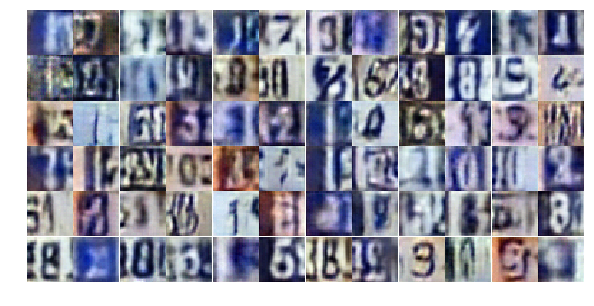

Epoch 12/20... Discriminator Loss: 0.9604... Generator Loss: 0.7792
Epoch 12/20... Discriminator Loss: 0.8766... Generator Loss: 1.0144
Epoch 12/20... Discriminator Loss: 1.0803... Generator Loss: 0.7901
Epoch 12/20... Discriminator Loss: 1.1630... Generator Loss: 0.8261
Epoch 12/20... Discriminator Loss: 0.9586... Generator Loss: 0.8948
Epoch 12/20... Discriminator Loss: 0.7801... Generator Loss: 0.8215
Epoch 12/20... Discriminator Loss: 0.7354... Generator Loss: 1.1617
Epoch 12/20... Discriminator Loss: 0.9102... Generator Loss: 1.3567
Epoch 12/20... Discriminator Loss: 0.7681... Generator Loss: 1.2832
Epoch 12/20... Discriminator Loss: 0.7750... Generator Loss: 1.0171


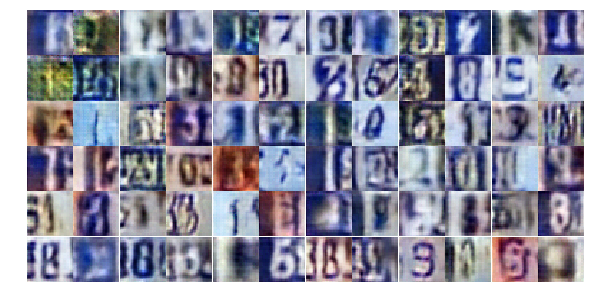

Epoch 12/20... Discriminator Loss: 0.9927... Generator Loss: 0.7633
Epoch 12/20... Discriminator Loss: 1.0654... Generator Loss: 0.7549
Epoch 12/20... Discriminator Loss: 1.0738... Generator Loss: 0.8951
Epoch 12/20... Discriminator Loss: 1.1292... Generator Loss: 0.6578
Epoch 12/20... Discriminator Loss: 1.0373... Generator Loss: 0.9683
Epoch 12/20... Discriminator Loss: 1.2830... Generator Loss: 0.4640
Epoch 12/20... Discriminator Loss: 1.3875... Generator Loss: 0.4824
Epoch 12/20... Discriminator Loss: 0.9561... Generator Loss: 1.1048
Epoch 12/20... Discriminator Loss: 0.9933... Generator Loss: 0.9209
Epoch 12/20... Discriminator Loss: 0.7355... Generator Loss: 1.4031


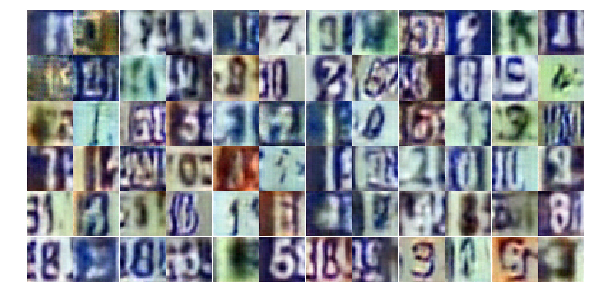

Epoch 12/20... Discriminator Loss: 0.9721... Generator Loss: 0.9909
Epoch 12/20... Discriminator Loss: 1.0468... Generator Loss: 0.7880
Epoch 12/20... Discriminator Loss: 0.9991... Generator Loss: 0.7730
Epoch 12/20... Discriminator Loss: 1.2332... Generator Loss: 0.6852
Epoch 12/20... Discriminator Loss: 1.1343... Generator Loss: 1.0638
Epoch 12/20... Discriminator Loss: 0.8767... Generator Loss: 0.9053
Epoch 12/20... Discriminator Loss: 0.9614... Generator Loss: 0.8223
Epoch 12/20... Discriminator Loss: 1.0474... Generator Loss: 0.8427
Epoch 12/20... Discriminator Loss: 1.0518... Generator Loss: 0.9099
Epoch 12/20... Discriminator Loss: 1.1149... Generator Loss: 0.7910


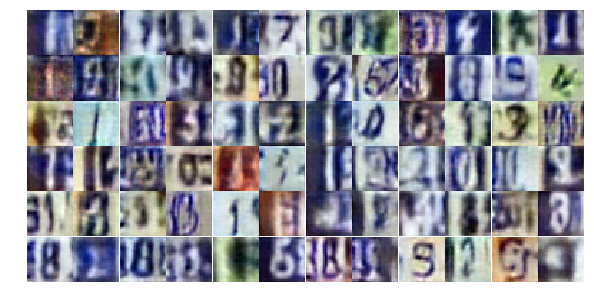

Epoch 12/20... Discriminator Loss: 1.0022... Generator Loss: 0.7816
Epoch 12/20... Discriminator Loss: 0.8106... Generator Loss: 1.0702
Epoch 12/20... Discriminator Loss: 1.0103... Generator Loss: 0.8578
Epoch 12/20... Discriminator Loss: 1.2797... Generator Loss: 0.8617
Epoch 12/20... Discriminator Loss: 0.8669... Generator Loss: 0.9941
Epoch 12/20... Discriminator Loss: 1.0135... Generator Loss: 0.9549
Epoch 12/20... Discriminator Loss: 1.1516... Generator Loss: 0.6849
Epoch 13/20... Discriminator Loss: 0.8168... Generator Loss: 1.1501
Epoch 13/20... Discriminator Loss: 0.9126... Generator Loss: 1.0857
Epoch 13/20... Discriminator Loss: 0.9854... Generator Loss: 0.8428


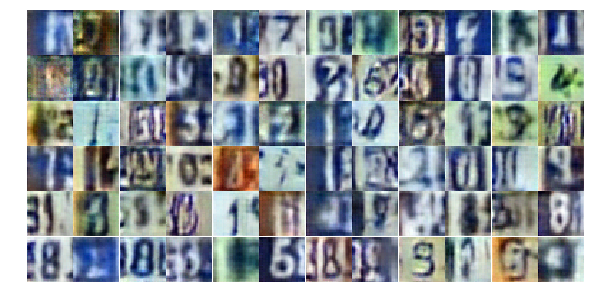

Epoch 13/20... Discriminator Loss: 0.9310... Generator Loss: 0.8689
Epoch 13/20... Discriminator Loss: 0.9913... Generator Loss: 0.9314
Epoch 13/20... Discriminator Loss: 1.1406... Generator Loss: 0.6856
Epoch 13/20... Discriminator Loss: 1.2864... Generator Loss: 0.5352
Epoch 13/20... Discriminator Loss: 1.1250... Generator Loss: 0.6347
Epoch 13/20... Discriminator Loss: 0.7822... Generator Loss: 1.0116
Epoch 13/20... Discriminator Loss: 0.8436... Generator Loss: 0.9713
Epoch 13/20... Discriminator Loss: 1.2581... Generator Loss: 0.5859
Epoch 13/20... Discriminator Loss: 0.9580... Generator Loss: 0.7936
Epoch 13/20... Discriminator Loss: 1.0124... Generator Loss: 1.0077


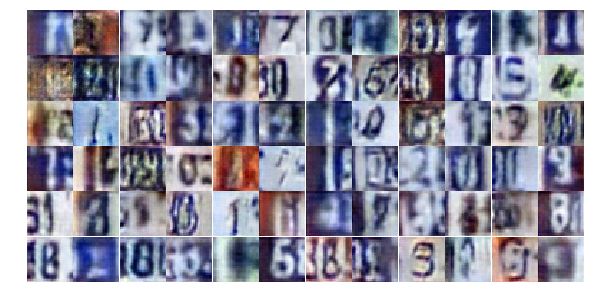

Epoch 13/20... Discriminator Loss: 0.9588... Generator Loss: 0.7516
Epoch 13/20... Discriminator Loss: 0.9515... Generator Loss: 0.8138
Epoch 13/20... Discriminator Loss: 1.0412... Generator Loss: 0.7816
Epoch 13/20... Discriminator Loss: 1.0169... Generator Loss: 1.0143
Epoch 13/20... Discriminator Loss: 0.8897... Generator Loss: 1.0551
Epoch 13/20... Discriminator Loss: 0.9254... Generator Loss: 0.8757
Epoch 13/20... Discriminator Loss: 0.9079... Generator Loss: 0.9733
Epoch 13/20... Discriminator Loss: 1.0060... Generator Loss: 1.2676
Epoch 13/20... Discriminator Loss: 0.7009... Generator Loss: 1.3703
Epoch 13/20... Discriminator Loss: 1.2514... Generator Loss: 0.5997


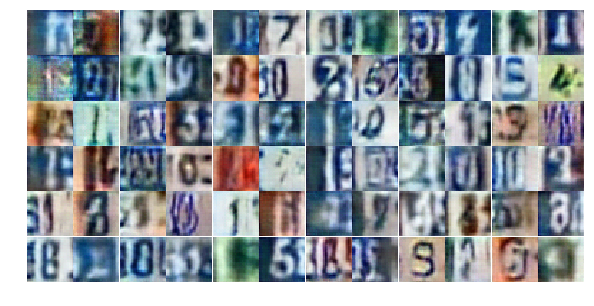

Epoch 13/20... Discriminator Loss: 0.9073... Generator Loss: 0.9255
Epoch 13/20... Discriminator Loss: 0.9692... Generator Loss: 0.8380
Epoch 13/20... Discriminator Loss: 0.9040... Generator Loss: 1.1089
Epoch 13/20... Discriminator Loss: 0.9736... Generator Loss: 0.7795
Epoch 13/20... Discriminator Loss: 0.9948... Generator Loss: 0.8197
Epoch 13/20... Discriminator Loss: 1.5983... Generator Loss: 0.3373
Epoch 13/20... Discriminator Loss: 1.0802... Generator Loss: 0.7920
Epoch 13/20... Discriminator Loss: 1.1483... Generator Loss: 1.0068
Epoch 13/20... Discriminator Loss: 1.0303... Generator Loss: 0.7104
Epoch 13/20... Discriminator Loss: 1.0677... Generator Loss: 0.8388


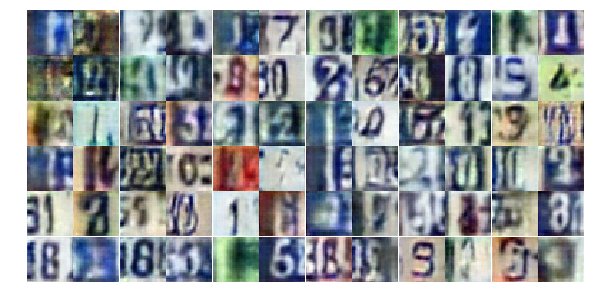

Epoch 13/20... Discriminator Loss: 1.1564... Generator Loss: 0.7171
Epoch 13/20... Discriminator Loss: 1.0888... Generator Loss: 0.6560
Epoch 13/20... Discriminator Loss: 1.2686... Generator Loss: 0.4511
Epoch 13/20... Discriminator Loss: 1.0986... Generator Loss: 0.7795
Epoch 13/20... Discriminator Loss: 0.8134... Generator Loss: 0.9805
Epoch 13/20... Discriminator Loss: 0.7364... Generator Loss: 1.1271
Epoch 13/20... Discriminator Loss: 0.9050... Generator Loss: 1.0975
Epoch 13/20... Discriminator Loss: 1.1452... Generator Loss: 0.6478
Epoch 13/20... Discriminator Loss: 1.2380... Generator Loss: 0.6389
Epoch 13/20... Discriminator Loss: 1.0365... Generator Loss: 0.9169


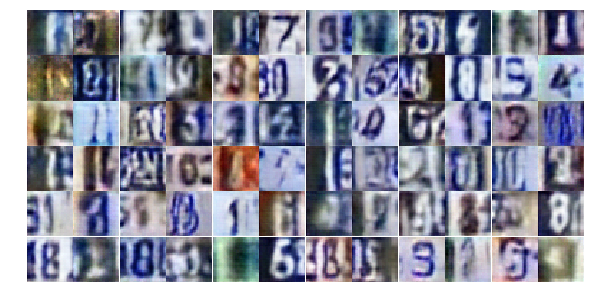

Epoch 13/20... Discriminator Loss: 1.0763... Generator Loss: 0.9529
Epoch 13/20... Discriminator Loss: 1.1315... Generator Loss: 0.6998
Epoch 13/20... Discriminator Loss: 1.1748... Generator Loss: 0.6095
Epoch 13/20... Discriminator Loss: 1.0250... Generator Loss: 0.6989
Epoch 13/20... Discriminator Loss: 1.3186... Generator Loss: 0.5265
Epoch 13/20... Discriminator Loss: 1.1124... Generator Loss: 0.6622
Epoch 13/20... Discriminator Loss: 1.0392... Generator Loss: 0.7590
Epoch 13/20... Discriminator Loss: 1.0355... Generator Loss: 0.8571
Epoch 13/20... Discriminator Loss: 0.9861... Generator Loss: 0.9683
Epoch 13/20... Discriminator Loss: 0.9692... Generator Loss: 0.8110


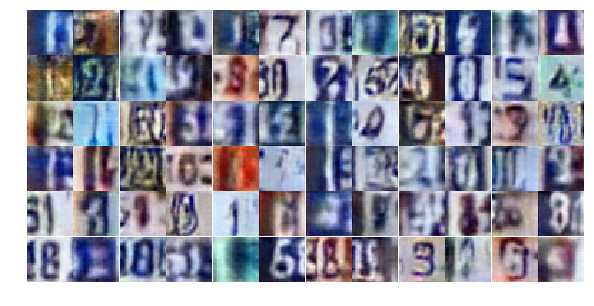

Epoch 13/20... Discriminator Loss: 0.7727... Generator Loss: 1.0635
Epoch 13/20... Discriminator Loss: 1.0322... Generator Loss: 0.7304
Epoch 13/20... Discriminator Loss: 0.9555... Generator Loss: 1.0019
Epoch 13/20... Discriminator Loss: 1.0607... Generator Loss: 0.6555
Epoch 14/20... Discriminator Loss: 1.2352... Generator Loss: 0.5120
Epoch 14/20... Discriminator Loss: 1.0579... Generator Loss: 1.0029
Epoch 14/20... Discriminator Loss: 1.1281... Generator Loss: 0.7333
Epoch 14/20... Discriminator Loss: 0.9716... Generator Loss: 1.3480
Epoch 14/20... Discriminator Loss: 0.9681... Generator Loss: 0.9948
Epoch 14/20... Discriminator Loss: 1.1595... Generator Loss: 0.5847


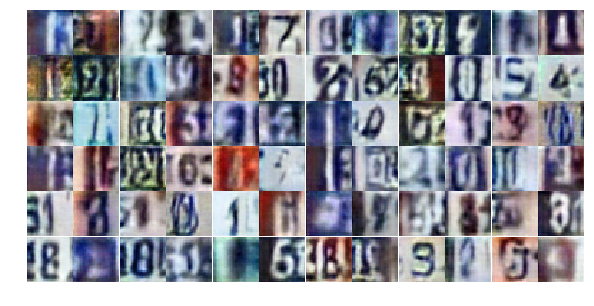

Epoch 14/20... Discriminator Loss: 1.3320... Generator Loss: 0.9564
Epoch 14/20... Discriminator Loss: 1.5679... Generator Loss: 0.2959
Epoch 14/20... Discriminator Loss: 0.9306... Generator Loss: 0.8304
Epoch 14/20... Discriminator Loss: 1.0209... Generator Loss: 0.8232
Epoch 14/20... Discriminator Loss: 1.1226... Generator Loss: 0.5804
Epoch 14/20... Discriminator Loss: 0.9091... Generator Loss: 1.0920
Epoch 14/20... Discriminator Loss: 0.8549... Generator Loss: 1.0284
Epoch 14/20... Discriminator Loss: 1.2923... Generator Loss: 0.4573
Epoch 14/20... Discriminator Loss: 1.0480... Generator Loss: 0.6693
Epoch 14/20... Discriminator Loss: 1.2232... Generator Loss: 0.5790


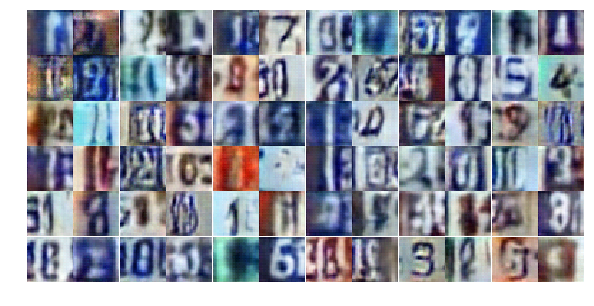

Epoch 14/20... Discriminator Loss: 0.6728... Generator Loss: 1.0922
Epoch 14/20... Discriminator Loss: 0.9536... Generator Loss: 1.3536
Epoch 14/20... Discriminator Loss: 1.2192... Generator Loss: 0.8245
Epoch 14/20... Discriminator Loss: 0.8722... Generator Loss: 1.1234
Epoch 14/20... Discriminator Loss: 1.0936... Generator Loss: 0.7285
Epoch 14/20... Discriminator Loss: 1.0055... Generator Loss: 0.8327
Epoch 14/20... Discriminator Loss: 1.0988... Generator Loss: 0.6595
Epoch 14/20... Discriminator Loss: 0.9673... Generator Loss: 0.8944
Epoch 14/20... Discriminator Loss: 0.9347... Generator Loss: 0.7536
Epoch 14/20... Discriminator Loss: 0.8170... Generator Loss: 0.9758


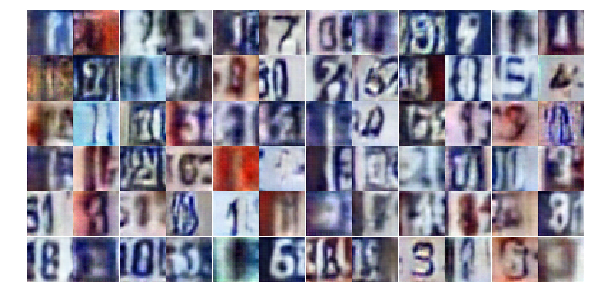

Epoch 14/20... Discriminator Loss: 1.2170... Generator Loss: 0.5467
Epoch 14/20... Discriminator Loss: 0.9117... Generator Loss: 1.1674
Epoch 14/20... Discriminator Loss: 1.0439... Generator Loss: 0.8677
Epoch 14/20... Discriminator Loss: 0.7571... Generator Loss: 1.2725
Epoch 14/20... Discriminator Loss: 0.9373... Generator Loss: 0.8567
Epoch 14/20... Discriminator Loss: 1.0508... Generator Loss: 0.7848
Epoch 14/20... Discriminator Loss: 1.0122... Generator Loss: 1.1804
Epoch 14/20... Discriminator Loss: 0.8645... Generator Loss: 0.9096
Epoch 14/20... Discriminator Loss: 0.9369... Generator Loss: 1.1175
Epoch 14/20... Discriminator Loss: 1.2251... Generator Loss: 0.6666


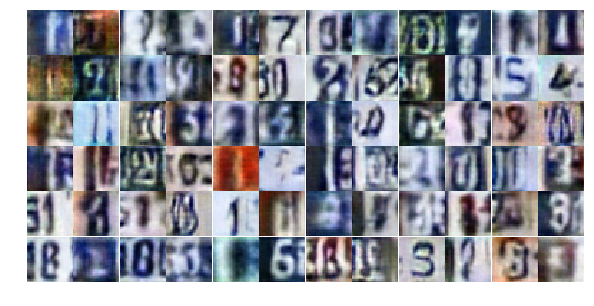

Epoch 14/20... Discriminator Loss: 1.2073... Generator Loss: 0.5646
Epoch 14/20... Discriminator Loss: 1.1808... Generator Loss: 0.7774
Epoch 14/20... Discriminator Loss: 0.8875... Generator Loss: 0.9475
Epoch 14/20... Discriminator Loss: 1.0919... Generator Loss: 0.7486
Epoch 14/20... Discriminator Loss: 1.1499... Generator Loss: 0.5508
Epoch 14/20... Discriminator Loss: 1.0356... Generator Loss: 0.7138
Epoch 14/20... Discriminator Loss: 0.9704... Generator Loss: 1.0145
Epoch 14/20... Discriminator Loss: 0.7783... Generator Loss: 1.2788
Epoch 14/20... Discriminator Loss: 0.7597... Generator Loss: 0.9396
Epoch 14/20... Discriminator Loss: 1.2590... Generator Loss: 0.8609


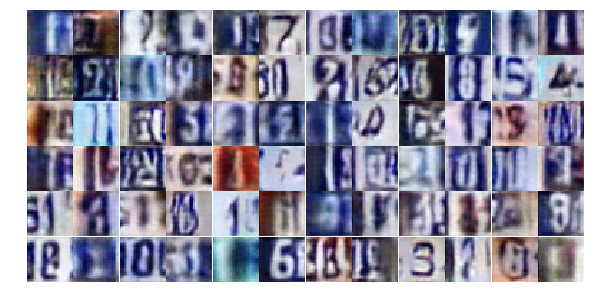

Epoch 14/20... Discriminator Loss: 1.3344... Generator Loss: 0.6434
Epoch 14/20... Discriminator Loss: 1.3250... Generator Loss: 0.5049
Epoch 14/20... Discriminator Loss: 1.2114... Generator Loss: 0.7631
Epoch 14/20... Discriminator Loss: 1.1484... Generator Loss: 0.6565
Epoch 14/20... Discriminator Loss: 1.2468... Generator Loss: 0.9545
Epoch 14/20... Discriminator Loss: 0.7832... Generator Loss: 1.1395
Epoch 14/20... Discriminator Loss: 0.9856... Generator Loss: 0.9228
Epoch 14/20... Discriminator Loss: 1.1186... Generator Loss: 0.9171
Epoch 14/20... Discriminator Loss: 1.2619... Generator Loss: 0.5531
Epoch 14/20... Discriminator Loss: 1.1458... Generator Loss: 0.5979


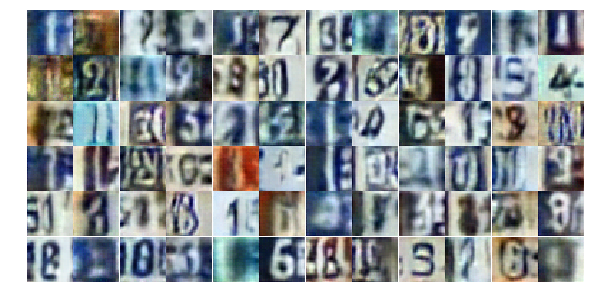

Epoch 14/20... Discriminator Loss: 1.2240... Generator Loss: 0.9587
Epoch 14/20... Discriminator Loss: 1.2342... Generator Loss: 0.5557
Epoch 15/20... Discriminator Loss: 0.9043... Generator Loss: 1.0535
Epoch 15/20... Discriminator Loss: 0.9480... Generator Loss: 0.8907
Epoch 15/20... Discriminator Loss: 0.8640... Generator Loss: 1.3049
Epoch 15/20... Discriminator Loss: 1.0780... Generator Loss: 0.6287
Epoch 15/20... Discriminator Loss: 1.0002... Generator Loss: 0.6928
Epoch 15/20... Discriminator Loss: 0.8434... Generator Loss: 0.9906
Epoch 15/20... Discriminator Loss: 1.1898... Generator Loss: 0.6600
Epoch 15/20... Discriminator Loss: 1.0430... Generator Loss: 0.7132


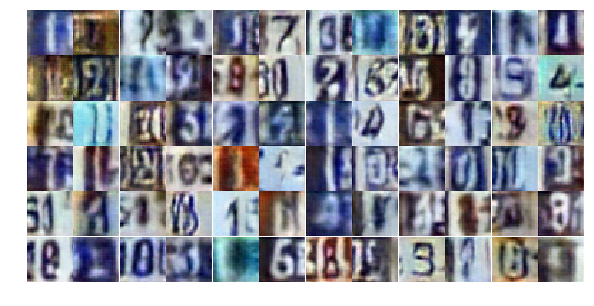

Epoch 15/20... Discriminator Loss: 1.0029... Generator Loss: 0.8029
Epoch 15/20... Discriminator Loss: 1.1819... Generator Loss: 0.6310
Epoch 15/20... Discriminator Loss: 1.0556... Generator Loss: 0.8024
Epoch 15/20... Discriminator Loss: 0.9919... Generator Loss: 1.0224
Epoch 15/20... Discriminator Loss: 1.1520... Generator Loss: 0.7831
Epoch 15/20... Discriminator Loss: 0.9933... Generator Loss: 0.8649
Epoch 15/20... Discriminator Loss: 1.3794... Generator Loss: 0.4740
Epoch 15/20... Discriminator Loss: 1.1669... Generator Loss: 0.7897
Epoch 15/20... Discriminator Loss: 0.9387... Generator Loss: 1.0243
Epoch 15/20... Discriminator Loss: 1.1311... Generator Loss: 0.6272


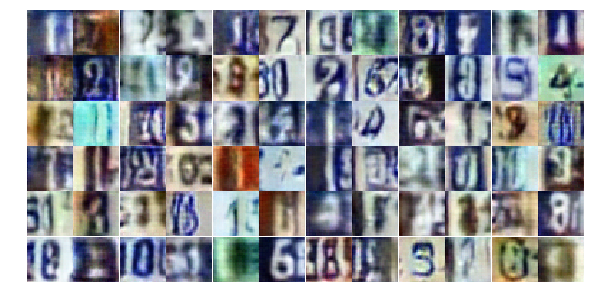

Epoch 15/20... Discriminator Loss: 1.2011... Generator Loss: 0.6901
Epoch 15/20... Discriminator Loss: 1.0125... Generator Loss: 0.9350
Epoch 15/20... Discriminator Loss: 0.9848... Generator Loss: 0.9143
Epoch 15/20... Discriminator Loss: 1.2062... Generator Loss: 0.5471
Epoch 15/20... Discriminator Loss: 1.2797... Generator Loss: 0.6331
Epoch 15/20... Discriminator Loss: 1.0472... Generator Loss: 0.6635
Epoch 15/20... Discriminator Loss: 1.1669... Generator Loss: 0.5944
Epoch 15/20... Discriminator Loss: 1.0352... Generator Loss: 0.6789
Epoch 15/20... Discriminator Loss: 1.0135... Generator Loss: 0.7205
Epoch 15/20... Discriminator Loss: 1.3166... Generator Loss: 0.4338


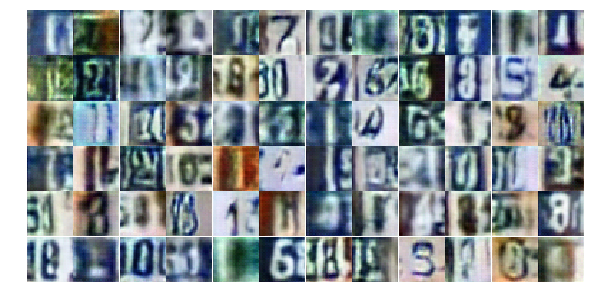

Epoch 15/20... Discriminator Loss: 1.1766... Generator Loss: 0.7093
Epoch 15/20... Discriminator Loss: 1.1181... Generator Loss: 0.5739
Epoch 15/20... Discriminator Loss: 0.8605... Generator Loss: 1.2328
Epoch 15/20... Discriminator Loss: 1.1082... Generator Loss: 0.8012
Epoch 15/20... Discriminator Loss: 1.2221... Generator Loss: 0.5982
Epoch 15/20... Discriminator Loss: 1.0362... Generator Loss: 1.1469
Epoch 15/20... Discriminator Loss: 0.8699... Generator Loss: 0.9384
Epoch 15/20... Discriminator Loss: 1.0527... Generator Loss: 1.1746
Epoch 15/20... Discriminator Loss: 1.0473... Generator Loss: 1.0022
Epoch 15/20... Discriminator Loss: 0.9401... Generator Loss: 1.0476


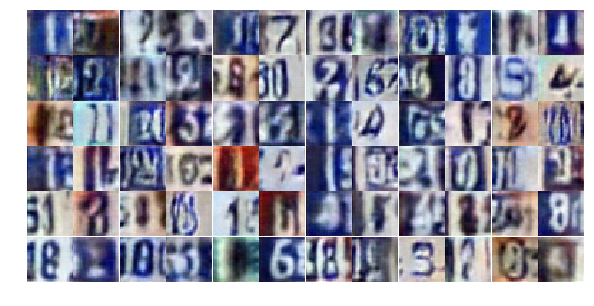

Epoch 15/20... Discriminator Loss: 1.1245... Generator Loss: 0.7612
Epoch 15/20... Discriminator Loss: 1.2750... Generator Loss: 0.4908
Epoch 15/20... Discriminator Loss: 1.1966... Generator Loss: 0.7393
Epoch 15/20... Discriminator Loss: 0.9334... Generator Loss: 1.0604
Epoch 15/20... Discriminator Loss: 0.9722... Generator Loss: 0.8076
Epoch 15/20... Discriminator Loss: 1.3633... Generator Loss: 0.4730
Epoch 15/20... Discriminator Loss: 0.8671... Generator Loss: 0.8544
Epoch 15/20... Discriminator Loss: 1.1171... Generator Loss: 0.7973
Epoch 15/20... Discriminator Loss: 1.2106... Generator Loss: 0.5710
Epoch 15/20... Discriminator Loss: 1.1366... Generator Loss: 0.8258


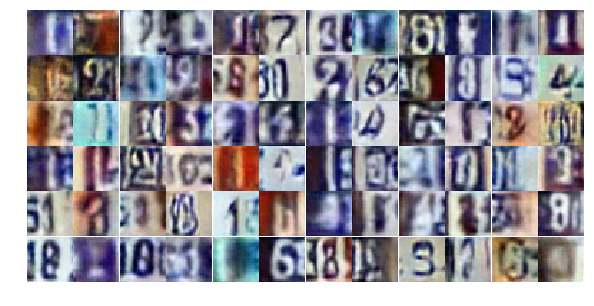

Epoch 15/20... Discriminator Loss: 1.1898... Generator Loss: 0.6832
Epoch 15/20... Discriminator Loss: 1.0775... Generator Loss: 0.7002
Epoch 15/20... Discriminator Loss: 0.9826... Generator Loss: 0.8095
Epoch 15/20... Discriminator Loss: 0.9211... Generator Loss: 0.7939
Epoch 15/20... Discriminator Loss: 1.0023... Generator Loss: 0.8031
Epoch 15/20... Discriminator Loss: 0.9479... Generator Loss: 0.8699
Epoch 15/20... Discriminator Loss: 1.0776... Generator Loss: 0.6249
Epoch 15/20... Discriminator Loss: 0.8423... Generator Loss: 1.0783
Epoch 15/20... Discriminator Loss: 1.4736... Generator Loss: 0.3815
Epoch 16/20... Discriminator Loss: 1.1303... Generator Loss: 0.7136


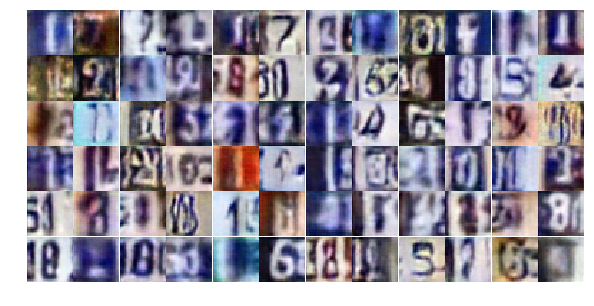

Epoch 16/20... Discriminator Loss: 1.0713... Generator Loss: 0.6409
Epoch 16/20... Discriminator Loss: 1.0730... Generator Loss: 1.0033
Epoch 16/20... Discriminator Loss: 1.1871... Generator Loss: 0.6213
Epoch 16/20... Discriminator Loss: 0.9066... Generator Loss: 1.1019
Epoch 16/20... Discriminator Loss: 1.0678... Generator Loss: 1.2503
Epoch 16/20... Discriminator Loss: 0.9355... Generator Loss: 1.0547
Epoch 16/20... Discriminator Loss: 1.2523... Generator Loss: 0.5751
Epoch 16/20... Discriminator Loss: 1.0461... Generator Loss: 0.6898
Epoch 16/20... Discriminator Loss: 0.7961... Generator Loss: 0.9556
Epoch 16/20... Discriminator Loss: 0.9491... Generator Loss: 0.7758


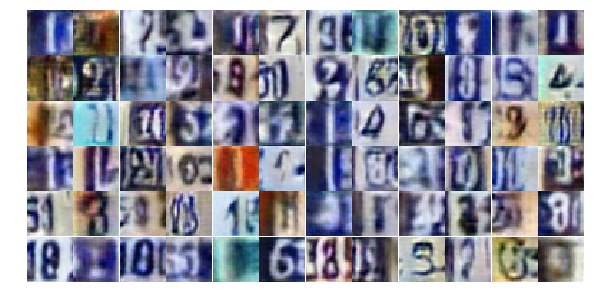

Epoch 16/20... Discriminator Loss: 1.0872... Generator Loss: 0.6006
Epoch 16/20... Discriminator Loss: 1.0145... Generator Loss: 0.7618
Epoch 16/20... Discriminator Loss: 1.0279... Generator Loss: 0.8160
Epoch 16/20... Discriminator Loss: 1.2970... Generator Loss: 0.5486
Epoch 16/20... Discriminator Loss: 0.8861... Generator Loss: 1.0713
Epoch 16/20... Discriminator Loss: 0.9944... Generator Loss: 0.7388
Epoch 16/20... Discriminator Loss: 1.1260... Generator Loss: 0.6045
Epoch 16/20... Discriminator Loss: 0.7325... Generator Loss: 1.1315
Epoch 16/20... Discriminator Loss: 0.9755... Generator Loss: 0.7907
Epoch 16/20... Discriminator Loss: 1.0091... Generator Loss: 1.1371


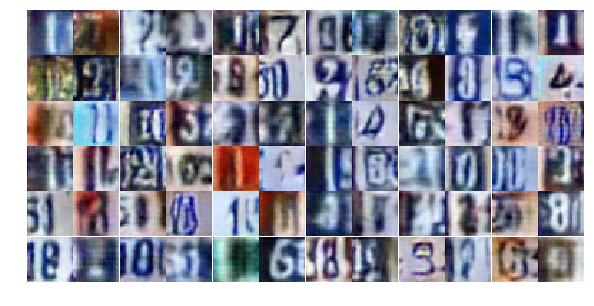

Epoch 16/20... Discriminator Loss: 1.0069... Generator Loss: 0.9564
Epoch 16/20... Discriminator Loss: 1.0684... Generator Loss: 0.8119
Epoch 16/20... Discriminator Loss: 1.1155... Generator Loss: 0.6872
Epoch 16/20... Discriminator Loss: 1.1411... Generator Loss: 0.5997
Epoch 16/20... Discriminator Loss: 0.9722... Generator Loss: 0.8900
Epoch 16/20... Discriminator Loss: 1.2232... Generator Loss: 0.5279
Epoch 16/20... Discriminator Loss: 1.0104... Generator Loss: 0.6754
Epoch 16/20... Discriminator Loss: 0.8504... Generator Loss: 0.9022
Epoch 16/20... Discriminator Loss: 1.1486... Generator Loss: 0.7715
Epoch 16/20... Discriminator Loss: 0.9537... Generator Loss: 0.6765


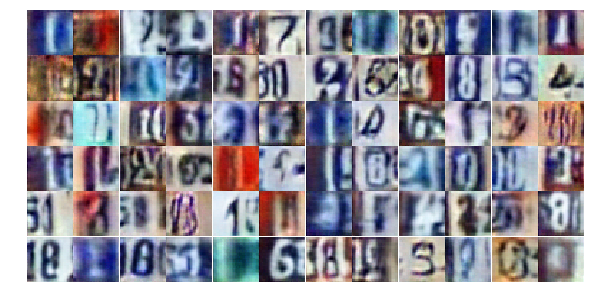

Epoch 16/20... Discriminator Loss: 0.9575... Generator Loss: 0.7635
Epoch 16/20... Discriminator Loss: 0.9510... Generator Loss: 1.0252
Epoch 16/20... Discriminator Loss: 0.9041... Generator Loss: 1.1256
Epoch 16/20... Discriminator Loss: 1.1564... Generator Loss: 0.8669
Epoch 16/20... Discriminator Loss: 1.1919... Generator Loss: 0.8965
Epoch 16/20... Discriminator Loss: 0.9755... Generator Loss: 1.0643
Epoch 16/20... Discriminator Loss: 1.0282... Generator Loss: 0.8389
Epoch 16/20... Discriminator Loss: 1.1815... Generator Loss: 0.5380
Epoch 16/20... Discriminator Loss: 1.0681... Generator Loss: 0.6940
Epoch 16/20... Discriminator Loss: 0.9579... Generator Loss: 1.2020


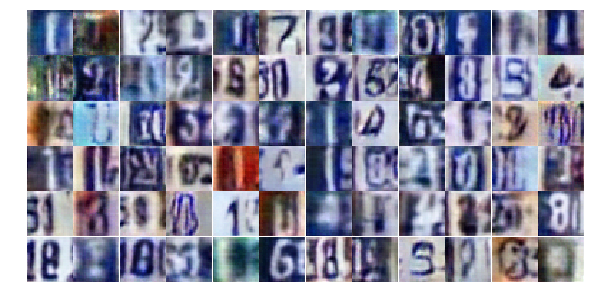

Epoch 16/20... Discriminator Loss: 0.9483... Generator Loss: 0.9779
Epoch 16/20... Discriminator Loss: 1.3091... Generator Loss: 0.4834
Epoch 16/20... Discriminator Loss: 1.0859... Generator Loss: 0.6443
Epoch 16/20... Discriminator Loss: 1.3441... Generator Loss: 0.4472
Epoch 16/20... Discriminator Loss: 1.1835... Generator Loss: 0.7651
Epoch 16/20... Discriminator Loss: 1.1982... Generator Loss: 0.5899
Epoch 16/20... Discriminator Loss: 0.8791... Generator Loss: 0.9453
Epoch 16/20... Discriminator Loss: 0.9680... Generator Loss: 0.9522
Epoch 16/20... Discriminator Loss: 0.8047... Generator Loss: 0.9716
Epoch 16/20... Discriminator Loss: 0.9915... Generator Loss: 0.7987


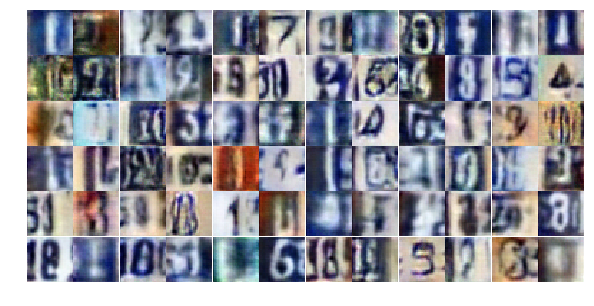

Epoch 16/20... Discriminator Loss: 1.0999... Generator Loss: 0.6128
Epoch 16/20... Discriminator Loss: 1.0014... Generator Loss: 0.9092
Epoch 16/20... Discriminator Loss: 1.3160... Generator Loss: 0.4356
Epoch 16/20... Discriminator Loss: 0.9333... Generator Loss: 0.8299
Epoch 16/20... Discriminator Loss: 0.9924... Generator Loss: 1.4350
Epoch 16/20... Discriminator Loss: 0.9188... Generator Loss: 0.8578
Epoch 17/20... Discriminator Loss: 0.8542... Generator Loss: 0.9075
Epoch 17/20... Discriminator Loss: 1.1042... Generator Loss: 0.6784
Epoch 17/20... Discriminator Loss: 0.9989... Generator Loss: 0.8680
Epoch 17/20... Discriminator Loss: 1.1319... Generator Loss: 0.6576


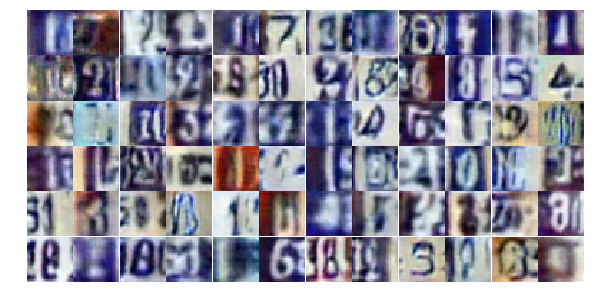

Epoch 17/20... Discriminator Loss: 0.7536... Generator Loss: 1.1354
Epoch 17/20... Discriminator Loss: 0.9376... Generator Loss: 0.7332
Epoch 17/20... Discriminator Loss: 1.0729... Generator Loss: 1.0109
Epoch 17/20... Discriminator Loss: 0.9273... Generator Loss: 0.9958
Epoch 17/20... Discriminator Loss: 1.1784... Generator Loss: 0.6147
Epoch 17/20... Discriminator Loss: 1.2883... Generator Loss: 0.4760
Epoch 17/20... Discriminator Loss: 1.4722... Generator Loss: 0.4652
Epoch 17/20... Discriminator Loss: 1.0896... Generator Loss: 0.5823
Epoch 17/20... Discriminator Loss: 0.8865... Generator Loss: 0.9277
Epoch 17/20... Discriminator Loss: 1.0836... Generator Loss: 0.8662


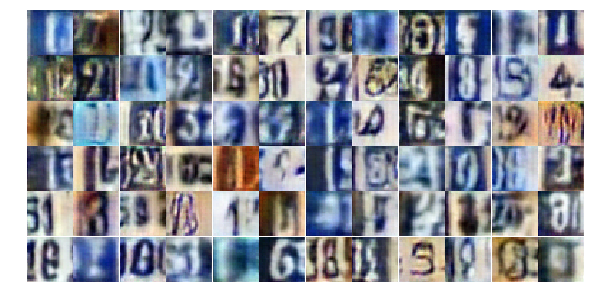

Epoch 17/20... Discriminator Loss: 1.1780... Generator Loss: 0.8667
Epoch 17/20... Discriminator Loss: 0.9508... Generator Loss: 1.0173
Epoch 17/20... Discriminator Loss: 0.6732... Generator Loss: 1.1355
Epoch 17/20... Discriminator Loss: 1.2713... Generator Loss: 0.5262
Epoch 17/20... Discriminator Loss: 1.1046... Generator Loss: 0.9676
Epoch 17/20... Discriminator Loss: 1.0814... Generator Loss: 0.6416
Epoch 17/20... Discriminator Loss: 0.8867... Generator Loss: 1.1335
Epoch 17/20... Discriminator Loss: 0.8929... Generator Loss: 0.9562
Epoch 17/20... Discriminator Loss: 0.9317... Generator Loss: 0.9798
Epoch 17/20... Discriminator Loss: 0.9874... Generator Loss: 0.7266


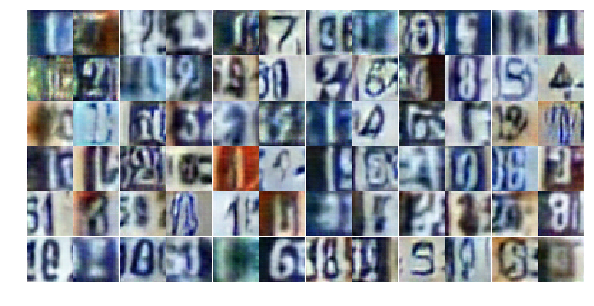

Epoch 17/20... Discriminator Loss: 1.3267... Generator Loss: 0.5117
Epoch 17/20... Discriminator Loss: 0.7086... Generator Loss: 1.2608
Epoch 17/20... Discriminator Loss: 0.8685... Generator Loss: 0.8943
Epoch 17/20... Discriminator Loss: 1.0837... Generator Loss: 0.7241
Epoch 17/20... Discriminator Loss: 1.1589... Generator Loss: 0.8859
Epoch 17/20... Discriminator Loss: 0.8661... Generator Loss: 1.0338
Epoch 17/20... Discriminator Loss: 0.9426... Generator Loss: 0.7057
Epoch 17/20... Discriminator Loss: 1.1846... Generator Loss: 0.6901
Epoch 17/20... Discriminator Loss: 1.1616... Generator Loss: 0.6186
Epoch 17/20... Discriminator Loss: 0.9842... Generator Loss: 0.8299


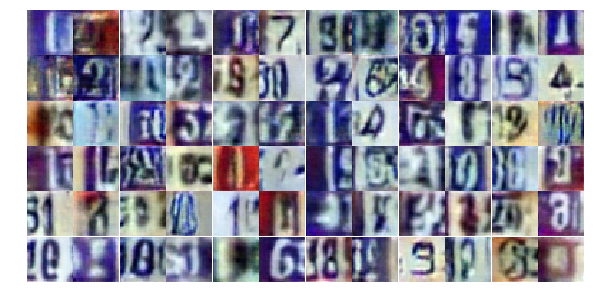

Epoch 17/20... Discriminator Loss: 0.9775... Generator Loss: 0.9039
Epoch 17/20... Discriminator Loss: 1.2883... Generator Loss: 0.5050
Epoch 17/20... Discriminator Loss: 1.0721... Generator Loss: 0.7238
Epoch 17/20... Discriminator Loss: 1.2100... Generator Loss: 1.2118
Epoch 17/20... Discriminator Loss: 1.3277... Generator Loss: 0.4975
Epoch 17/20... Discriminator Loss: 0.9825... Generator Loss: 0.9145
Epoch 17/20... Discriminator Loss: 1.0922... Generator Loss: 1.1731
Epoch 17/20... Discriminator Loss: 0.9532... Generator Loss: 0.9468
Epoch 17/20... Discriminator Loss: 0.7228... Generator Loss: 1.2759
Epoch 17/20... Discriminator Loss: 1.1135... Generator Loss: 0.6790


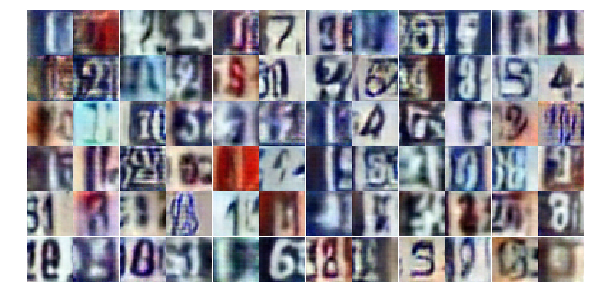

Epoch 17/20... Discriminator Loss: 1.2009... Generator Loss: 0.7428
Epoch 17/20... Discriminator Loss: 0.7998... Generator Loss: 1.5192
Epoch 17/20... Discriminator Loss: 1.1034... Generator Loss: 0.8659
Epoch 17/20... Discriminator Loss: 0.7489... Generator Loss: 1.0598
Epoch 17/20... Discriminator Loss: 1.0868... Generator Loss: 0.6940
Epoch 17/20... Discriminator Loss: 1.2115... Generator Loss: 0.7121
Epoch 17/20... Discriminator Loss: 1.0116... Generator Loss: 0.7327
Epoch 17/20... Discriminator Loss: 1.0661... Generator Loss: 0.7093
Epoch 17/20... Discriminator Loss: 0.8483... Generator Loss: 0.9041
Epoch 17/20... Discriminator Loss: 1.1025... Generator Loss: 0.7225


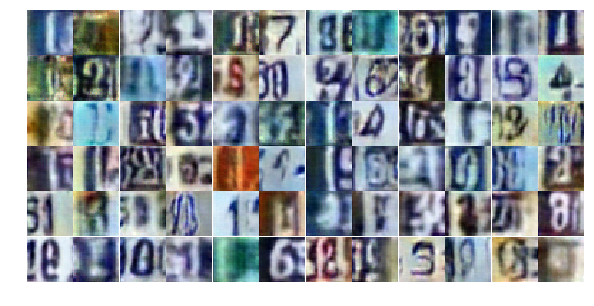

Epoch 17/20... Discriminator Loss: 0.9539... Generator Loss: 1.1314
Epoch 17/20... Discriminator Loss: 1.0831... Generator Loss: 0.7188
Epoch 17/20... Discriminator Loss: 1.1164... Generator Loss: 0.7329
Epoch 17/20... Discriminator Loss: 0.9264... Generator Loss: 1.0739
Epoch 18/20... Discriminator Loss: 1.2656... Generator Loss: 0.5190
Epoch 18/20... Discriminator Loss: 1.1194... Generator Loss: 0.6471
Epoch 18/20... Discriminator Loss: 1.0686... Generator Loss: 0.7359
Epoch 18/20... Discriminator Loss: 1.1771... Generator Loss: 0.6331
Epoch 18/20... Discriminator Loss: 1.1777... Generator Loss: 0.5566
Epoch 18/20... Discriminator Loss: 1.2146... Generator Loss: 0.4851


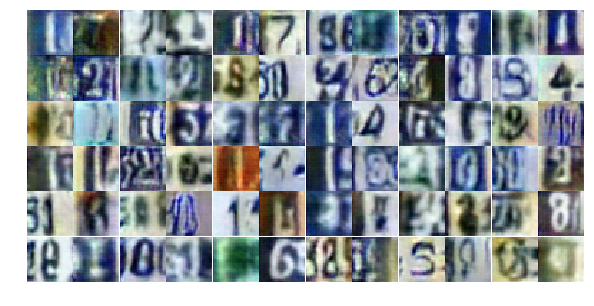

Epoch 18/20... Discriminator Loss: 0.5728... Generator Loss: 1.3386
Epoch 18/20... Discriminator Loss: 1.2487... Generator Loss: 0.5465
Epoch 18/20... Discriminator Loss: 1.3192... Generator Loss: 0.5125
Epoch 18/20... Discriminator Loss: 0.8795... Generator Loss: 0.9693
Epoch 18/20... Discriminator Loss: 0.8010... Generator Loss: 1.1936
Epoch 18/20... Discriminator Loss: 1.0963... Generator Loss: 0.6810
Epoch 18/20... Discriminator Loss: 0.9076... Generator Loss: 1.0557
Epoch 18/20... Discriminator Loss: 1.1922... Generator Loss: 0.5186
Epoch 18/20... Discriminator Loss: 0.8893... Generator Loss: 1.0395
Epoch 18/20... Discriminator Loss: 0.8779... Generator Loss: 1.3654


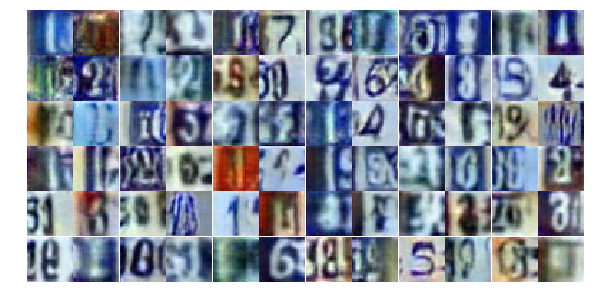

Epoch 18/20... Discriminator Loss: 1.1197... Generator Loss: 0.7599
Epoch 18/20... Discriminator Loss: 1.1462... Generator Loss: 0.7199
Epoch 18/20... Discriminator Loss: 1.1148... Generator Loss: 0.6399
Epoch 18/20... Discriminator Loss: 0.8712... Generator Loss: 1.1035
Epoch 18/20... Discriminator Loss: 0.8669... Generator Loss: 0.8351
Epoch 18/20... Discriminator Loss: 0.9926... Generator Loss: 0.9009
Epoch 18/20... Discriminator Loss: 1.2002... Generator Loss: 0.8038
Epoch 18/20... Discriminator Loss: 1.1010... Generator Loss: 0.6234
Epoch 18/20... Discriminator Loss: 1.0214... Generator Loss: 0.7477
Epoch 18/20... Discriminator Loss: 1.1142... Generator Loss: 0.6203


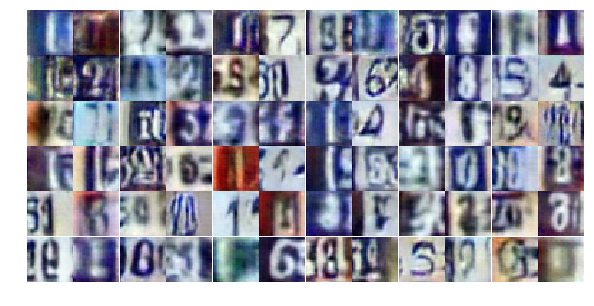

Epoch 18/20... Discriminator Loss: 1.0976... Generator Loss: 0.6092
Epoch 18/20... Discriminator Loss: 1.0531... Generator Loss: 1.1683
Epoch 18/20... Discriminator Loss: 0.9932... Generator Loss: 0.8204
Epoch 18/20... Discriminator Loss: 0.8958... Generator Loss: 0.9045
Epoch 18/20... Discriminator Loss: 1.4012... Generator Loss: 0.4291
Epoch 18/20... Discriminator Loss: 1.2068... Generator Loss: 0.5322
Epoch 18/20... Discriminator Loss: 1.1098... Generator Loss: 0.7002
Epoch 18/20... Discriminator Loss: 0.9409... Generator Loss: 0.9571
Epoch 18/20... Discriminator Loss: 0.8725... Generator Loss: 0.8762
Epoch 18/20... Discriminator Loss: 0.9999... Generator Loss: 1.0224


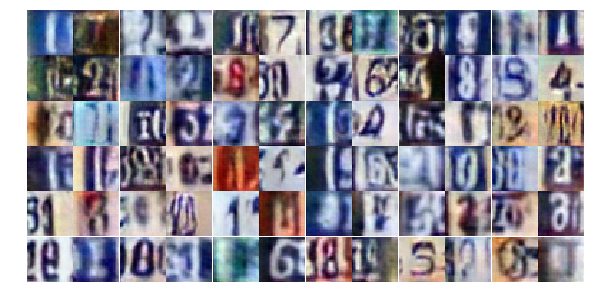

Epoch 18/20... Discriminator Loss: 0.8374... Generator Loss: 1.0780
Epoch 18/20... Discriminator Loss: 0.9580... Generator Loss: 0.8169
Epoch 18/20... Discriminator Loss: 0.9872... Generator Loss: 0.7157
Epoch 18/20... Discriminator Loss: 1.0740... Generator Loss: 1.3661
Epoch 18/20... Discriminator Loss: 1.3990... Generator Loss: 0.6687
Epoch 18/20... Discriminator Loss: 0.9449... Generator Loss: 0.7094
Epoch 18/20... Discriminator Loss: 1.1955... Generator Loss: 0.5790
Epoch 18/20... Discriminator Loss: 1.1216... Generator Loss: 0.9984
Epoch 18/20... Discriminator Loss: 1.1560... Generator Loss: 0.5802
Epoch 18/20... Discriminator Loss: 0.9791... Generator Loss: 0.6875


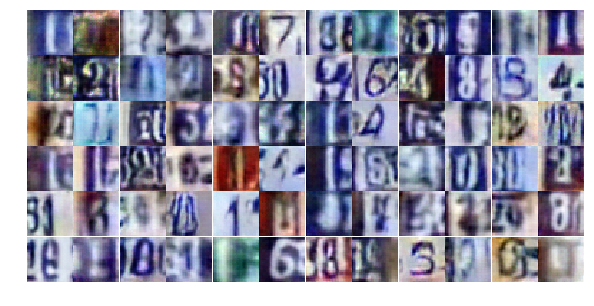

Epoch 18/20... Discriminator Loss: 0.9802... Generator Loss: 0.8517
Epoch 18/20... Discriminator Loss: 0.8875... Generator Loss: 1.0804
Epoch 18/20... Discriminator Loss: 1.1551... Generator Loss: 0.6547
Epoch 18/20... Discriminator Loss: 1.0913... Generator Loss: 0.6503
Epoch 18/20... Discriminator Loss: 1.1059... Generator Loss: 0.7612
Epoch 18/20... Discriminator Loss: 1.0876... Generator Loss: 0.6637
Epoch 18/20... Discriminator Loss: 0.9189... Generator Loss: 0.9046
Epoch 18/20... Discriminator Loss: 0.8817... Generator Loss: 0.9686
Epoch 18/20... Discriminator Loss: 1.1350... Generator Loss: 0.7242
Epoch 18/20... Discriminator Loss: 0.8928... Generator Loss: 0.8768


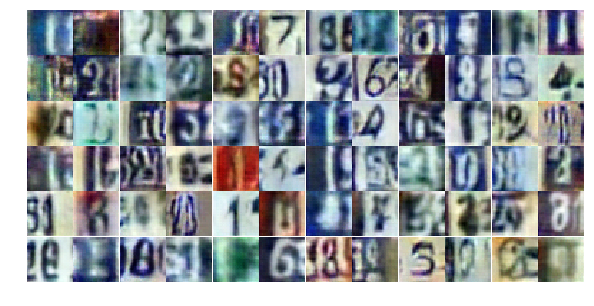

Epoch 18/20... Discriminator Loss: 1.2112... Generator Loss: 1.5652
Epoch 19/20... Discriminator Loss: 1.2491... Generator Loss: 0.5752
Epoch 19/20... Discriminator Loss: 1.1630... Generator Loss: 0.6879
Epoch 19/20... Discriminator Loss: 1.2631... Generator Loss: 0.6026
Epoch 19/20... Discriminator Loss: 1.1368... Generator Loss: 0.6242
Epoch 19/20... Discriminator Loss: 1.2839... Generator Loss: 0.4894
Epoch 19/20... Discriminator Loss: 0.9549... Generator Loss: 0.9954
Epoch 19/20... Discriminator Loss: 1.1971... Generator Loss: 0.7049
Epoch 19/20... Discriminator Loss: 0.9314... Generator Loss: 1.2172
Epoch 19/20... Discriminator Loss: 1.2511... Generator Loss: 0.5549


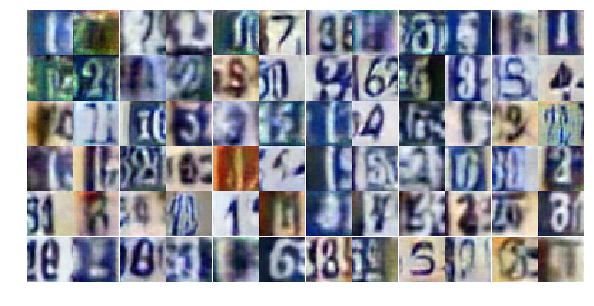

Epoch 19/20... Discriminator Loss: 1.0753... Generator Loss: 0.6506
Epoch 19/20... Discriminator Loss: 1.3171... Generator Loss: 0.4860
Epoch 19/20... Discriminator Loss: 1.1048... Generator Loss: 0.6784
Epoch 19/20... Discriminator Loss: 1.1457... Generator Loss: 0.6170
Epoch 19/20... Discriminator Loss: 1.1076... Generator Loss: 0.6510
Epoch 19/20... Discriminator Loss: 1.1365... Generator Loss: 0.6498
Epoch 19/20... Discriminator Loss: 0.8782... Generator Loss: 0.9771
Epoch 19/20... Discriminator Loss: 0.9193... Generator Loss: 0.9383
Epoch 19/20... Discriminator Loss: 1.1146... Generator Loss: 0.7446
Epoch 19/20... Discriminator Loss: 1.1240... Generator Loss: 0.6435


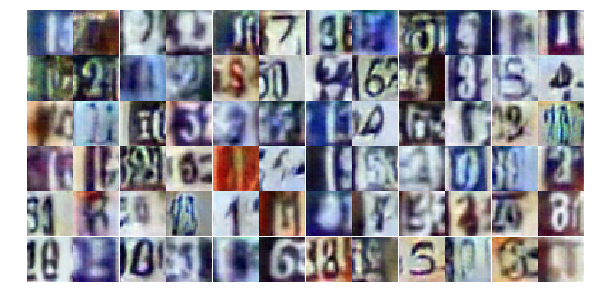

Epoch 19/20... Discriminator Loss: 1.0486... Generator Loss: 0.6807
Epoch 19/20... Discriminator Loss: 1.4528... Generator Loss: 0.4598
Epoch 19/20... Discriminator Loss: 1.2438... Generator Loss: 0.5410
Epoch 19/20... Discriminator Loss: 1.1802... Generator Loss: 0.6206
Epoch 19/20... Discriminator Loss: 1.1086... Generator Loss: 0.6419
Epoch 19/20... Discriminator Loss: 1.0766... Generator Loss: 0.8011
Epoch 19/20... Discriminator Loss: 1.0103... Generator Loss: 0.8643
Epoch 19/20... Discriminator Loss: 1.0046... Generator Loss: 0.7881
Epoch 19/20... Discriminator Loss: 1.0050... Generator Loss: 0.9870
Epoch 19/20... Discriminator Loss: 1.3432... Generator Loss: 0.5101


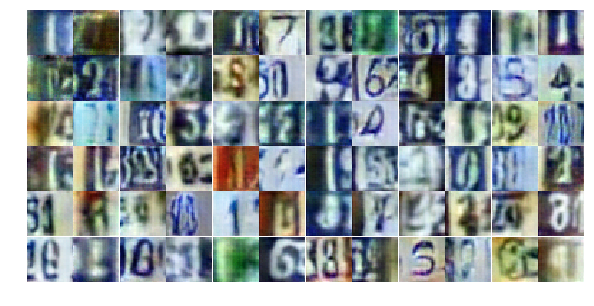

Epoch 19/20... Discriminator Loss: 1.0064... Generator Loss: 0.8885
Epoch 19/20... Discriminator Loss: 0.8819... Generator Loss: 0.9536
Epoch 19/20... Discriminator Loss: 1.1930... Generator Loss: 0.5520
Epoch 19/20... Discriminator Loss: 1.1185... Generator Loss: 0.6671
Epoch 19/20... Discriminator Loss: 0.9503... Generator Loss: 0.7702
Epoch 19/20... Discriminator Loss: 0.9243... Generator Loss: 0.8900
Epoch 19/20... Discriminator Loss: 0.9231... Generator Loss: 0.8982
Epoch 19/20... Discriminator Loss: 0.8896... Generator Loss: 1.1025
Epoch 19/20... Discriminator Loss: 1.1845... Generator Loss: 0.6654
Epoch 19/20... Discriminator Loss: 1.1042... Generator Loss: 0.6606


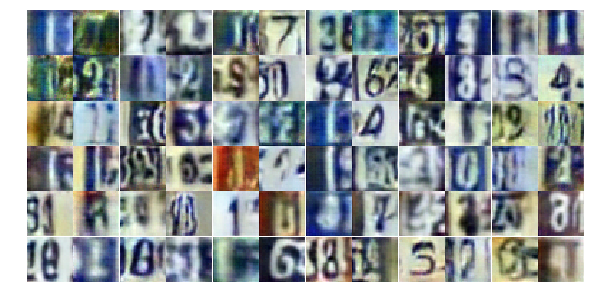

Epoch 19/20... Discriminator Loss: 0.9453... Generator Loss: 0.9319
Epoch 19/20... Discriminator Loss: 1.1182... Generator Loss: 0.7173
Epoch 19/20... Discriminator Loss: 1.0023... Generator Loss: 0.7248
Epoch 19/20... Discriminator Loss: 1.1937... Generator Loss: 0.6498
Epoch 19/20... Discriminator Loss: 1.6154... Generator Loss: 2.5952
Epoch 19/20... Discriminator Loss: 1.0431... Generator Loss: 0.8112
Epoch 19/20... Discriminator Loss: 1.0429... Generator Loss: 0.8492
Epoch 19/20... Discriminator Loss: 0.8589... Generator Loss: 1.0846
Epoch 19/20... Discriminator Loss: 0.9775... Generator Loss: 0.8006
Epoch 19/20... Discriminator Loss: 1.3009... Generator Loss: 0.7253


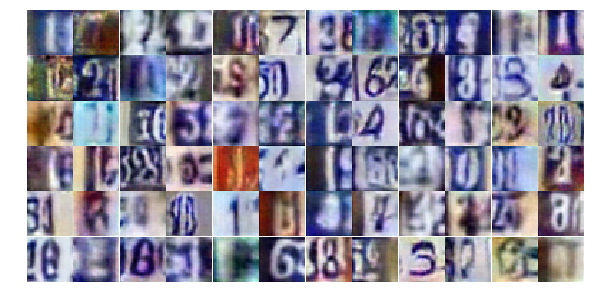

Epoch 19/20... Discriminator Loss: 1.3489... Generator Loss: 0.4194
Epoch 19/20... Discriminator Loss: 1.0268... Generator Loss: 0.7985
Epoch 19/20... Discriminator Loss: 1.0504... Generator Loss: 0.8029
Epoch 19/20... Discriminator Loss: 1.1537... Generator Loss: 0.7596
Epoch 19/20... Discriminator Loss: 1.1543... Generator Loss: 0.8855
Epoch 19/20... Discriminator Loss: 1.0813... Generator Loss: 0.7496
Epoch 19/20... Discriminator Loss: 1.4539... Generator Loss: 0.3576
Epoch 19/20... Discriminator Loss: 0.7790... Generator Loss: 1.2403
Epoch 20/20... Discriminator Loss: 1.2623... Generator Loss: 0.6907
Epoch 20/20... Discriminator Loss: 1.0574... Generator Loss: 0.7024


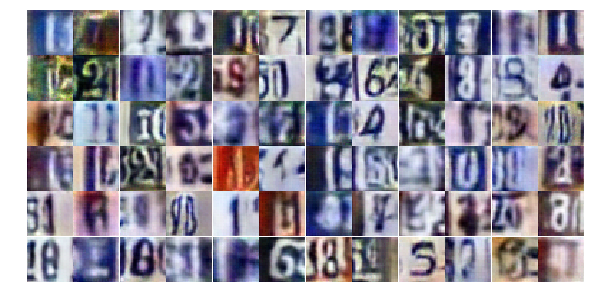

Epoch 20/20... Discriminator Loss: 0.9753... Generator Loss: 0.8939
Epoch 20/20... Discriminator Loss: 1.0902... Generator Loss: 0.6426
Epoch 20/20... Discriminator Loss: 1.4385... Generator Loss: 0.3901
Epoch 20/20... Discriminator Loss: 1.1010... Generator Loss: 0.6204
Epoch 20/20... Discriminator Loss: 0.8354... Generator Loss: 1.0426
Epoch 20/20... Discriminator Loss: 1.0353... Generator Loss: 0.8735
Epoch 20/20... Discriminator Loss: 0.9304... Generator Loss: 0.9664
Epoch 20/20... Discriminator Loss: 1.1485... Generator Loss: 0.7621
Epoch 20/20... Discriminator Loss: 1.3976... Generator Loss: 1.2129
Epoch 20/20... Discriminator Loss: 0.8622... Generator Loss: 0.9591


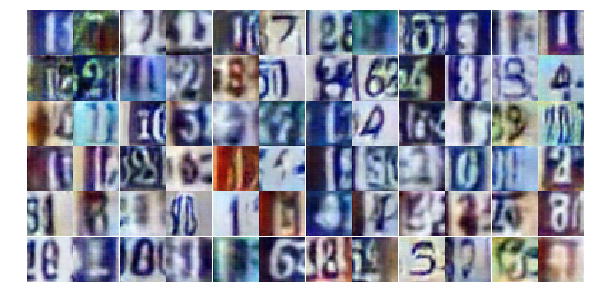

Epoch 20/20... Discriminator Loss: 1.1338... Generator Loss: 0.5583
Epoch 20/20... Discriminator Loss: 1.3888... Generator Loss: 0.5527
Epoch 20/20... Discriminator Loss: 1.0936... Generator Loss: 0.7837
Epoch 20/20... Discriminator Loss: 1.0812... Generator Loss: 0.8370
Epoch 20/20... Discriminator Loss: 1.4459... Generator Loss: 0.3843
Epoch 20/20... Discriminator Loss: 1.1691... Generator Loss: 0.5789
Epoch 20/20... Discriminator Loss: 1.2936... Generator Loss: 0.4600
Epoch 20/20... Discriminator Loss: 0.8642... Generator Loss: 1.0043
Epoch 20/20... Discriminator Loss: 0.9286... Generator Loss: 0.8533
Epoch 20/20... Discriminator Loss: 1.3270... Generator Loss: 0.5045


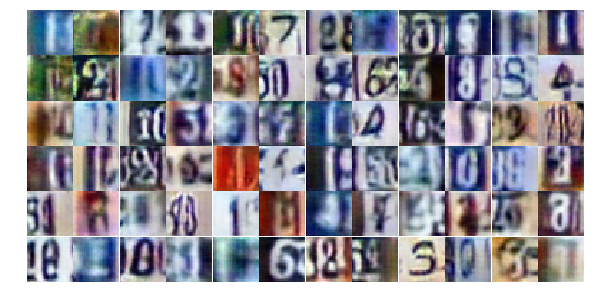

Epoch 20/20... Discriminator Loss: 0.9487... Generator Loss: 0.8395
Epoch 20/20... Discriminator Loss: 1.1167... Generator Loss: 0.6580
Epoch 20/20... Discriminator Loss: 0.7700... Generator Loss: 1.1792
Epoch 20/20... Discriminator Loss: 1.4375... Generator Loss: 0.3980
Epoch 20/20... Discriminator Loss: 1.1644... Generator Loss: 0.6727
Epoch 20/20... Discriminator Loss: 0.9707... Generator Loss: 0.7883
Epoch 20/20... Discriminator Loss: 1.1318... Generator Loss: 1.6799
Epoch 20/20... Discriminator Loss: 1.0797... Generator Loss: 0.6523
Epoch 20/20... Discriminator Loss: 1.1235... Generator Loss: 0.8341
Epoch 20/20... Discriminator Loss: 0.7055... Generator Loss: 0.9965


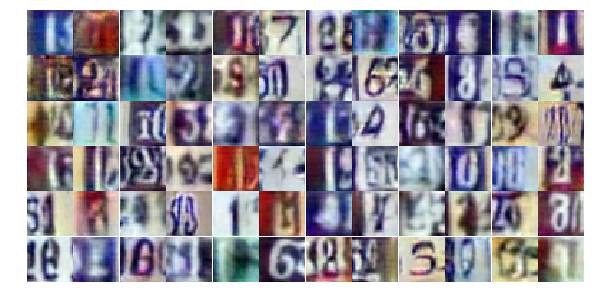

Epoch 20/20... Discriminator Loss: 1.1894... Generator Loss: 0.6647
Epoch 20/20... Discriminator Loss: 0.8621... Generator Loss: 0.8952
Epoch 20/20... Discriminator Loss: 1.2461... Generator Loss: 0.5989
Epoch 20/20... Discriminator Loss: 1.1227... Generator Loss: 0.9350
Epoch 20/20... Discriminator Loss: 1.0474... Generator Loss: 0.6757
Epoch 20/20... Discriminator Loss: 1.0524... Generator Loss: 0.7146
Epoch 20/20... Discriminator Loss: 1.2453... Generator Loss: 0.9502
Epoch 20/20... Discriminator Loss: 1.1387... Generator Loss: 0.7783
Epoch 20/20... Discriminator Loss: 0.8380... Generator Loss: 1.0662
Epoch 20/20... Discriminator Loss: 1.2007... Generator Loss: 0.5615


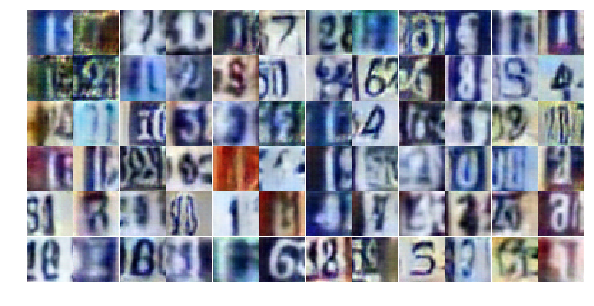

Epoch 20/20... Discriminator Loss: 1.3417... Generator Loss: 0.5098
Epoch 20/20... Discriminator Loss: 1.0198... Generator Loss: 0.7392
Epoch 20/20... Discriminator Loss: 1.0849... Generator Loss: 1.2355
Epoch 20/20... Discriminator Loss: 1.2889... Generator Loss: 0.4857
Epoch 20/20... Discriminator Loss: 1.1364... Generator Loss: 0.8650
Epoch 20/20... Discriminator Loss: 1.3361... Generator Loss: 0.5080
Epoch 20/20... Discriminator Loss: 1.1549... Generator Loss: 0.9509
Epoch 20/20... Discriminator Loss: 0.9060... Generator Loss: 1.0936
Epoch 20/20... Discriminator Loss: 1.0263... Generator Loss: 0.6522
Epoch 20/20... Discriminator Loss: 0.8720... Generator Loss: 0.8935


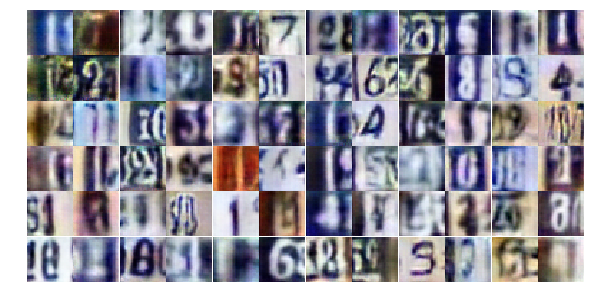

Epoch 20/20... Discriminator Loss: 0.8595... Generator Loss: 1.0154
Epoch 20/20... Discriminator Loss: 1.2982... Generator Loss: 0.4980
Epoch 20/20... Discriminator Loss: 0.8394... Generator Loss: 1.0197
Epoch 20/20... Discriminator Loss: 1.1173... Generator Loss: 0.9992
Epoch 20/20... Discriminator Loss: 1.1901... Generator Loss: 0.5450
Epoch 20/20... Discriminator Loss: 0.6308... Generator Loss: 1.5718


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

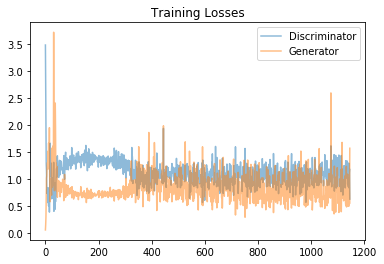

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

/anaconda3/envs/gan/lib/python3.6/site-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


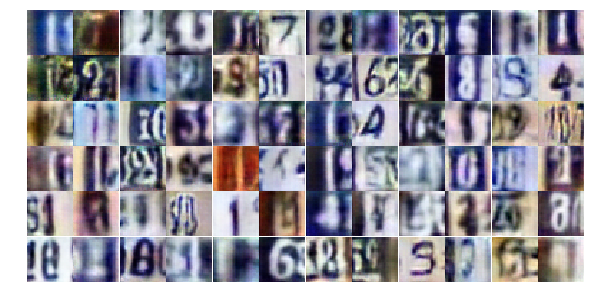

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))